# Imports / Configs 

In [1]:
import math
import os
import pickle
from itertools import permutations

import tensorflow as tf
import tensorflow_probability as tfp
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
from mpl_toolkits.axes_grid1 import make_axes_locatable
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
from tqdm.notebook import tqdm
from brainiak.isc import isc
from brainiak.fcma.util import compute_correlation
from sklearn.model_selection import KFold, LeaveOneOut
import scipy.spatial.distance as sp_distance
from scipy import stats
from ipywidgets import interact, FloatSlider

import plot_utils as ptools
from shared_gpfa import SharedGpfa
from srm import SRM, RSRM
from ea_data_loader import load_ea_data, get_atlas_ticks

%load_ext autoreload
%autoreload 2


%matplotlib inline
plt.style.use('ggplot')
mpl.rcParams['legend.frameon'] = True
mpl.rcParams['legend.fancybox'] = True
mpl.rcParams['legend.facecolor'] = 'w'
mpl.rcParams['legend.fontsize'] = 15
mpl.rcParams['font.size'] = 14
# mpl.rcParams['xtick.direction'] = mpl.rcParams['ytick.direction'] = 'in'
# mpl.rcParams['xtick.major.size'] = mpl.rcParams['ytick.major.size'] = 5

# sns.set()

colors = {'other': 'crimson',
          'sgpfa': 'dodgerblue',
          'srm': 'seagreen'}
# colors = {'other': 'red',
#           'sgpfa': 'blue',
#           'srm': 'green'}


tfd = tfp.distributions
tfb = tfp.bijectors
dtype = np.float32
platform = 'camh'

print('tf version:', tf.__version__)
print('tfp version:', tfp.__version__)
print(tf.config.list_physical_devices('GPU'))

tf version: 2.2.0
tfp version: 0.10.0
[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [2]:
def mse(y_true, y_hat):
    se = (y_true - y_hat) ** 2
    mse = se.mean(-1)
    return mse, mse.mean(-1), mse.std(-1)


def mat_corr(x, y, axis=0):
    r = []
    for _x, _y in zip(x, y):
        r.append(stats.pearsonr(_x, _y)[0])
    return np.array(r)

# Simulated Data

## SGPFA generated data

In [31]:
# tf.random.set_seed(1)
# np.random.seed(1)

# p = 2
# q = 40
# m = 20
# t = 200

# length_scale = np.array([1, 6])
# subject_noise_scale = np.linspace(.1, .5, m)
# roi_noise_scale = np.linspace(.1, .5, q)

# smoothness = 1 and 50
# sm_factor = None
# reg = 1
# loss = sgpfa.fit(
#     train_data=[train_data],
#     n_iters=1000,
#     learning_rate=0.05,
#     tensorboard=False,
#     fa_init=False,
#     reg=reg,
#     smoothness=smoothness,
#     sm_factor=sm_factor
# )



# ___________________________________

# tf.random.set_seed(1)
# np.random.seed(1)

# p = 2
# q = 50
# m = 20
# t = 200

# length_scale = np.array([1, 6])
# subject_noise_scale = np.linspace(.1, .5, m)
# roi_noise_scale = np.linspace(.1, .5, q)


# sgpfa = SharedGpfa(m, q, p, color=colors['sgpfa'])
# smoothness = 1 and 50
# sm_factor = None
# reg = 1
# loss = sgpfa.fit(
#     train_data=[train_data],
#     n_iters=1000,
#     learning_rate=0.05,
#     tensorboard=False,
#     fa_init=False,
#     reg=reg,
#     smoothness=smoothness,
#     sm_factor=sm_factor
# )

In [12]:
tf.random.set_seed(1)
np.random.seed(1)

# Simulate data:
p = 2
q = 50
m = 20
t = 200

# length_scale = np.arange(1, p + 1)
length_scale = np.array([1, 6])
# length_scale = np.array([5, 1])
subject_noise_scale = np.linspace(.1, .5, m)
roi_noise_scale = np.linspace(.1, .5, q)

# length_scale = np.array([1, 4])
# subject_noise_scale = np.array([0.1]*m)
# roi_noise_scale = np.array([0.1]*q)

generator = SharedGpfa(m, q, p, name='Ground Truth', color=colors['other'])
generator.t = [t]
generator.init_vars()
generator.init_joint()
generator.vars['length_scale'].assign(length_scale)
generator.vars['subject_noise_scale'].assign(subject_noise_scale)
generator.vars['roi_noise_scale'].assign(roi_noise_scale)

s = generator.joint[0].sample()
generator.vars['x'][0].assign(s['x'])
generator.vars['w'].assign(s['w'])
train_data = s['obs'].numpy()
generator.sort()

50.0


Instructions for updating:
Do not pass `graph_parents`.  They will  no longer be used.



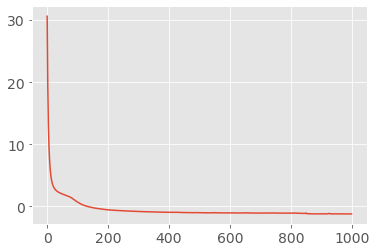

In [13]:
# fit SGPFA
sgpfa = SharedGpfa(m, q, p, color=colors['sgpfa'])
smoothness = 1
sm_factor = 10
reg = 1
loss = sgpfa.fit(
    train_data=[train_data],
    n_iters=1000,
    learning_rate=0.05,
    tensorboard=False,
    fa_init=False,
    reg=reg,
    smoothness=smoothness,
    sm_factor=sm_factor
)
sgpfa.sort()

plt.plot(loss);

In [17]:
# fit SRM
srm = SRM(n_iter=30, features=p, color=colors['srm'])
srm.fit(train_data)
srm.sort()

In [154]:
%matplotlib notebook

for model in (sgpfa, generator):
    print(f'------- {model.name} -------')
    print(f'tau:\t {model.len_scale()}')
    print('Loss:\t', model.train_loss(train_data, smoothness=smoothness, reg=reg, normalize=False).numpy())
    for key, val in model.log_prob_parts(train_data).items():
        print(f'{key}:\t{-val.numpy()}')

ncols = min(3, p)
nrows = math.ceil(p / ncols)
fig, axs = plt.subplots(nrows, ncols, figsize=(20, 5), sharex=False, sharey=True, constrained_layout=True)
fig.suptitle('Normalized Latent Trajectories', fontsize=15)
for model, c in zip((generator, srm), ('r', 'g')):
    for ax, x in zip(axs.flat, model.traj()):
        ax.plot(x / x.std(), label=model.name, color=c)
    
    
def plot(t):
    R = np.array([[np.cos(t), -np.sin(t)], [np.sin(t), np.cos(t)]])
    for ax, x_est, x_true in zip(axs.flat, R @ sgpfa.traj(), generator.traj()):
        [l.remove() for l in ax.lines if 'SGPFA' in l.get_label()]
        corr = stats.pearsonr(x_est, x_true)[0]
        ax.plot(x_est / x_est.std(), color='b', label=f'SGPFA, corr = {corr:.3f}', alpha=0.7)
        ax.legend(loc=1)
        
        
f = FloatSlider(min=0., max=2. * np.pi, step=0.05, value=0.)
interact(plot, t=f);

------- SGPFA -------
tau:	 [1.7722577 1.9770013]
Loss:	 -233811.28
x:	-84.4388427734375
w:	2591.65185546875
obs:	-236318.5
------- True -------
tau:	 [ 5. 50.]
Loss:	 443510.84
x:	676606.5
w:	2856.9287109375
obs:	-235952.59375


<IPython.core.display.Javascript object>

interactive(children=(FloatSlider(value=0.0, description='t', max=6.283185307179586, step=0.05), Output()), _d…

<IPython.core.display.Javascript object>

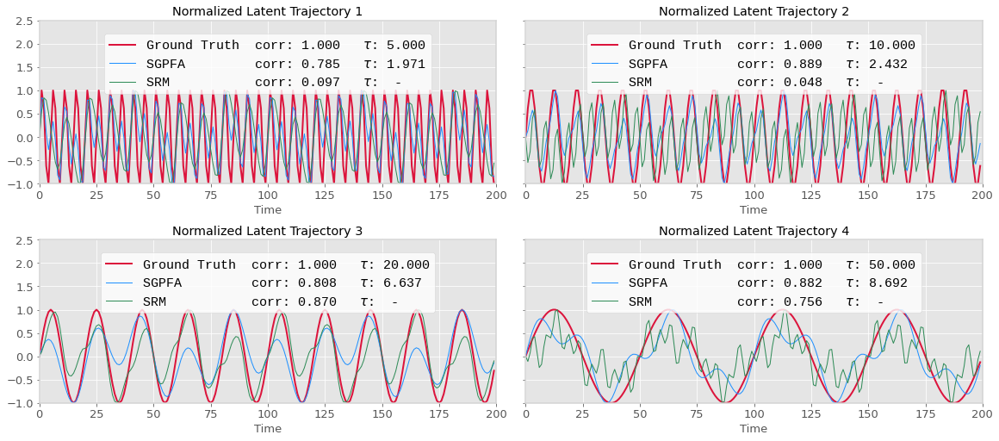

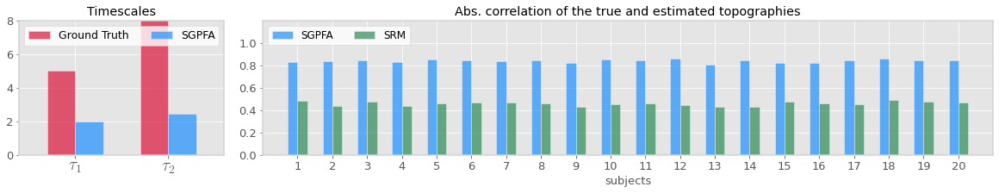

In [228]:
%matplotlib inline

# plot results:

# latent trajectories
ncols = min(2, p)
nrows = math.ceil(p / ncols)
fig1, axs = plt.subplots(nrows, ncols, figsize=(16, 3.5 * nrows), sharex=False, sharey=True, constrained_layout=True)
ptools.spine(fig1)
ptools.font_size(fig1, 13)

for model, lw, a in zip((generator, sgpfa, srm), (2, 1, 1), (1, 1, 1)):
    c = model.color
    for ax, x_est, x_true, tau, i in zip(axs.flat, model.traj(), generator.traj(), model.len_scale(), range(p)):
        corr = stats.pearsonr(x_est, x_true)[0]
        label = (model.name
                 + " " * (len(generator.name) - len(model.name) + 2)
                 + f'corr: {abs(corr):.3f}' 
                 + " " * 3
                 + fr'$\tau$: ' + (f'{tau:.3f}' if not model.name == 'SRM' else ' - ')
                )
        ax.plot(np.sign(corr) * x_est / np.abs(x_est).max(), color=c, label=label, lw=lw, alpha=a)
#         ax.set_ylim(-1, 1)
#         ax.legend(loc='lower center', bbox_to_anchor=(0.5,1.15), borderaxespad=0)
        ax.legend(loc='upper center', borderaxespad=1, prop={'family': 'Liberation Mono', 'size': 15})
        ax.set_xlim(0, t)
        ax.set_ylim(-1, 2.5)
        ax.set_xlabel('Time')
        ax.set_title(f'Normalized Latent Trajectory {i+1}')
        
# Model Parameters
figsize = (16, 3)
fig2, axs = plt.subplots(1, 2, figsize=figsize, constrained_layout=True, gridspec_kw={'width_ratios': [1.4, 5]})
ptools.spine(fig2)
ptools.font_size(fig2, 13)

for model, label, pos in zip((generator, sgpfa), ('Ground Truth', 'SGPFA'), (-1, 1)):
    w = 0.3
    axs[0].set_title('Timescales')
    axs[0].bar(np.arange(p) + pos * w / 2, model.len_scale(), alpha=0.7, label=label, color=model.color, width=w, ec='w')
    axs[0].set_xticks(np.arange(p))
    axs[0].set_xticklabels([fr'$\tau_{i}$' for i in np.arange(1, p + 1)], usetex=True, fontsize=20)
    axs[0].set_ylim(0, 8)
    axs[0].set_xlim(-.6, 1.6)
    axs[0].legend(fontsize=12.5, loc='upper center', ncol=2)

w = 0.28
# axs[1].bar(0, np.nan, label=generator.name, color=generator.color, alpha=alpha)
for model, offset in zip((sgpfa, srm), (-1, 1)):
    w_true = generator.weights()
    w_est = model.weights()
    r = []
    for _w_est, _w_true in zip(w_est, w_true):
        _r = np.abs(mat_corr(_w_est.T, _w_true.T)).mean()
        r.append(_r)
    axs[1].bar(np.arange(m) + offset * w / 2, r, label=model.name, width=w, color=model.color, alpha=0.7, ec='w')
axs[1].set_xticks(np.arange(0, m, 1))
axs[1].set_xticklabels(np.arange(1, m + 1, 1))
axs[1].set_yticks(np.arange(0, 1.2, .2))
axs[1].set_xlabel('subjects')
axs[1].set_title('Abs. correlation of the true and estimated topographies')
axs[1].set_ylim(0, 1.2)
axs[1].set_xlim(-1, m)
axs[1].legend(fontsize=12, ncol=2, loc='upper left')

# handles, labels = axs[1].get_legend_handles_labels()
# leg = fig2.legend(handles, labels, loc='center right', ncol=1, bbox_to_anchor=(0, 0.5), bbox_transform=fig2.transFigure)

## Sin latent trajectories

In [233]:
tf.random.set_seed(1)
np.random.seed(1)

# Simulate data:
p = 4
q = 30
m = 20
t = 200

# freq = np.array([0.005, .05, .01, 0.15])

freq = np.array([.02, .05, .1, .2])

# freq = np.array([.01, .05, .1, .2])

# freq = np.array([.02, .2])

subject_noise_scale = np.linspace(.1, .5, m)
roi_noise_scale = np.linspace(.1, .5, q)

generator = SharedGpfa(m, q, p, name='Ground Truth', color=colors['other'])
generator.t = [t]
generator.init_vars()
generator.init_joint()
generator.vars['length_scale'].assign(1 / freq)
generator.vars['subject_noise_scale'].assign(subject_noise_scale)
generator.vars['roi_noise_scale'].assign(roi_noise_scale)

w_true = generator.joint[0].model['w'].sample().numpy()
x_true = np.array([np.sin(2 * np.pi * f * np.arange(t)) for f in freq]).astype(generator.dtype)
train_data = generator.joint[0].model['obs'](x_true, w_true).sample().numpy()

generator.vars['x'][0].assign(x_true)
generator.vars['w'].assign(w_true);
generator.sort()

In [237]:
# fit SGPFA
sgpfa = SharedGpfa(m, q, p, color=colors['sgpfa'])
smoothness = 1
sm_factor = 10
reg = 1
loss = sgpfa.fit(
    train_data=[train_data],
    n_iters=1200,
    learning_rate=0.05,
    tensorboard=False,
    fa_init=False,
    reg=reg,
    smoothness=smoothness,
    sm_factor=sm_factor
)
sgpfa.sort()

# fit SRM
srm = SRM(n_iter=30, features=p, color=colors['srm'])
srm.fit(train_data)
srm.sort()

15.0


KeyboardInterrupt: 

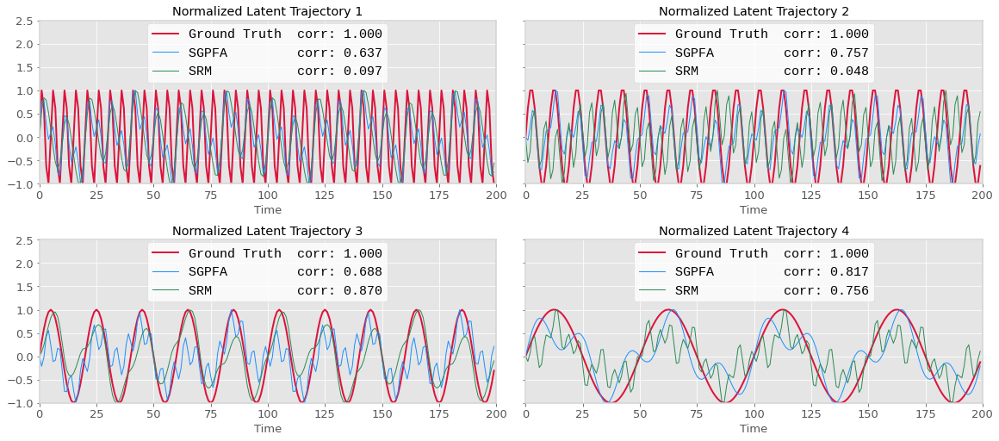

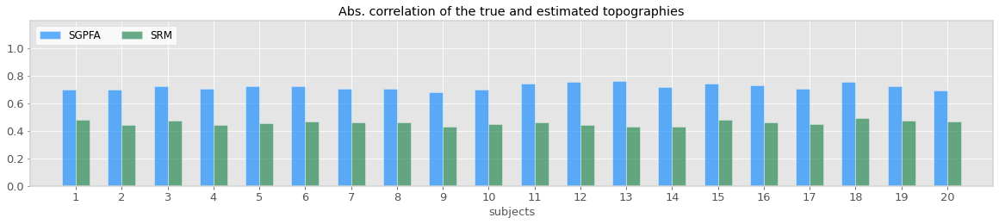

In [235]:
%matplotlib inline

# plot results:

# latent trajectories
ncols = min(2, p)
nrows = math.ceil(p / ncols)
fig1, axs = plt.subplots(nrows, ncols, figsize=(16, 3.5 * nrows), sharex=False, sharey=True, constrained_layout=True)
ptools.spine(fig1)
ptools.font_size(fig1, 13)

for model, lw, a in zip((generator, sgpfa, srm), (2, 1, 1), (1, 1, 1)):
    c = model.color
    for ax, x_est, x_true, tau, i in zip(axs.flat, model.traj(), generator.traj(), model.len_scale(), range(p)):
        corr = stats.pearsonr(x_est, x_true)[0]
        label = (model.name
                 + " " * (len(generator.name) - len(model.name) + 2)
                 + f'corr: {abs(corr):.3f}'
                )
        ax.plot(np.sign(corr) * x_est / np.abs(x_est).max(), color=c, label=label, lw=lw, alpha=a)
#         ax.set_ylim(-1, 1)
#         ax.legend(loc='lower center', bbox_to_anchor=(0.5,1.15), borderaxespad=0)
        ax.legend(loc='upper center', borderaxespad=0.2, prop={'family': 'Liberation Mono', 'size': 15})
        ax.set_xlim(0, t)
        ax.set_ylim(-1, 2.5)
        ax.set_xlabel('Time')
        ax.set_title(f'Normalized Latent Trajectory {i+1}')


# Model Parameters
figsize = (16, 3.5)
fig2, ax = plt.subplots(figsize=figsize, constrained_layout=True)
ptools.spine(fig2)
ptools.font_size(fig2, 13)

for model, offset in zip((sgpfa, srm), (-1, 1)):
    w_true = generator.weights()
    w_est = model.weights()
    r = []
    for _w_est, _w_true in zip(w_est, w_true):
        _r = np.abs(mat_corr(_w_est.T, _w_true.T)).mean()
        r.append(_r)
    ax.bar(np.arange(m) + offset * w / 2, r, label=model.name, width=w, color=model.color, alpha=0.7, ec='w')
ax.set_xticks(np.arange(0, m, 1))
ax.set_xticklabels(np.arange(1, m + 1, 1))
ax.set_yticks(np.arange(0, 1.2, .2))
ax.set_xlabel('subjects')
ax.set_title('Abs. correlation of the true and estimated topographies')
ax.set_ylim(0, 1.2)
ax.set_xlim(-1, m)
ax.legend(fontsize=12, ncol=2, loc='upper left')

In [236]:
fig1.savefig('Figures/sim/sin/sin_traj_1.pdf')
fig2.savefig('Figures/sim/sin/sin_par_1.pdf')

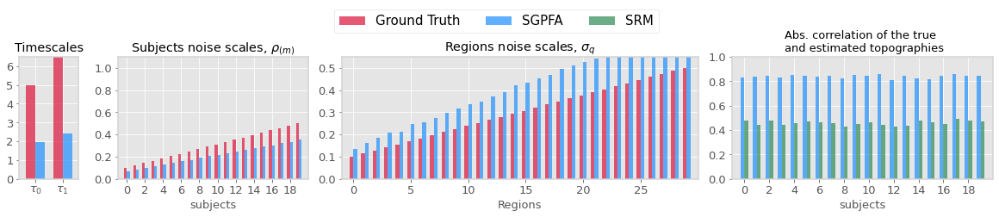

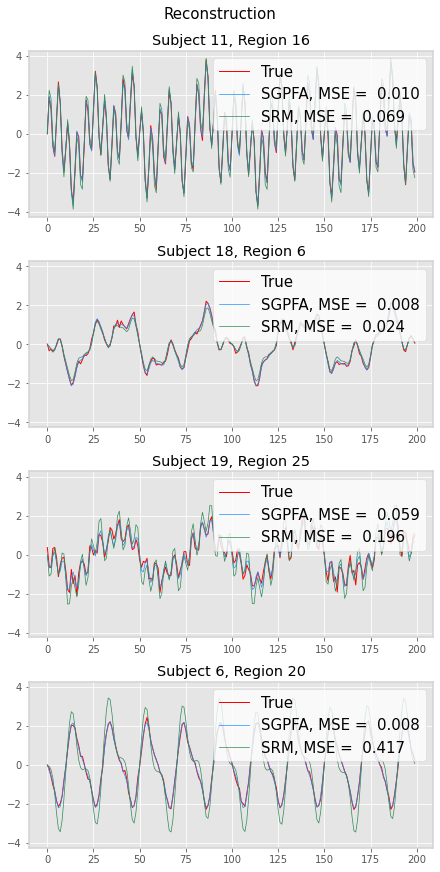

In [229]:
# mapping weights
# ncols = min(4, p)
# nrows = math.ceil(p / ncols)
# ptools.spine(fig)
# for model in (sgpfa, srm):
#     fig, axs = plt.subplots(nrows, ncols, figsize=(18, 4 * nrows), sharex=True, sharey=True, constrained_layout=True)
#     fig.suptitle(model.name, fontsize=15)
#     w_est = model.weights() / model.weights().std(1, keepdims=True)
#     w_true = generator.weights() / generator.weights().std(1, keepdims=True)
#     vmax = np.abs(w_est - w_true).max()
#     for i, ax in zip(range(p), axs.flat):
#         r = [stats.pearsonr(w_est[sub, :, i], w_true[sub, :, i])[0] for sub in range(m)]
#         ax.set_title(f'{i} - corr: {np.mean(r):.3f}')
#         im = ax.matshow(np.abs(w_est[:, :, i] - w_true[:, :, i]), cmap='hot', vmin=0, vmax=vmax)
#         ax.set_xlabel('region')
#         ax.set_ylabel('subject')
#         ax.grid(False)
#         fig.colorbar(im, ax=ax, orientation='vertical' if m > q else 'horizontal')
#         ax.set_xticks([])

# w = 0.3
# fig, ax = plt.subplots(figsize=(8, 4))
# ptools.spine(fig)
# for model, offset in zip((sgpfa, srm), (-1, 1)):
#     w_true = generator.weights().reshape((m, -1))
#     w_est = model.weights().reshape((m, -1))
#     r = []
#     for _w_est, _w_true in zip(w_est, w_true):
#         r.append(abs(stats.pearsonr(_w_est, _w_true)[0]))
#     ax.bar(np.arange(m) + offset * w / 2, r, label=model.name, width=w, color=model.color)
# ax.set_xticks(np.arange(m))
# ax.legend()
# ax.set_xlabel('subjects')
# ax.set_ylabel('Abs. correlation')
# ax.set_title('Abs. correaltion of true and estimated topographies')
# ax.set_ylim(0, 1)
        
# Model Parameters
figsize = (16, 3)
fig2, axs = plt.subplots(1, 4, figsize=figsize, constrained_layout=True, gridspec_kw={'width_ratios': [0.5, 1.6, 3, 2.2]})
ptools.spine(fig2)
ptools.font_size(fig2, 13)
# fig.suptitle('Parameters', fontsize=15)
alpha = 0.7

for model, label, _alpha, pos in zip((generator, sgpfa), ('Ground Truth', 'SGPFA'), (alpha, alpha), (-1, 1)):
    w = 0.35
    axs[0].set_title('Timescales')
    axs[0].bar(np.arange(p) + pos * w / 2, model.len_scale(), alpha=_alpha, label=label, color=model.color, width=w)
#     axs[0].legend(loc=2, ncol=1)
    axs[0].set_xticks(np.arange(p))
    axs[0].set_xticklabels([fr'$\tau_{i}$' for i in range(p)])
    axs[0].set_ylim(0, 6.5)
    axs[0].set_xlim(-.6, 1.6)
    
    w = 0.65 / 2
    axs[1].set_title(r'Subjects noise scales, $\rho_{(m)}$')
    axs[1].bar(np.arange(m) + pos * w / 2, model.sub_noise(), label=label, color=model.color, alpha=_alpha, width=w)
    axs[1].set_xlabel('subjects')
#     axs[1].legend(loc=2)
    axs[1].set_xticks(np.arange(0, m, 2))
    axs[1].tick_params(axis='both')
    axs[1].set_ylim(0, 1.1)
    axs[1].set_xlim(-1, m)

    w = 0.65 / 2
    axs[2].set_title('Regions noise scales, $\sigma_q$')
    axs[2].bar(np.arange(q) + pos * w / 2, model.reg_noise(), label=label, color=model.color, alpha=_alpha, width=w)
    axs[2].set_xlabel('Regions')
#     axs[2].legend(loc=2)
    axs[2].set_xticks(np.arange(0, q, 5))
    axs[2].tick_params(axis='both')
    axs[2].set_ylim(0, .55)
    axs[2].set_xlim(-1, q)

#     axs[3].set_title('overal observations noise scale')
#     noise = model.sub_noise()[:, None] * model.reg_noise()
#     axs[3].bar(np.arange(q * m), noise.reshape(-1), label=label, color=model.color, alpha=alpha, width=1)
#     axs[3].set_xlabel('Subjects/Regions')
#     axs[3].legend(loc=2)
#     axs[3].set_xticks(np.arange(0, m * q, q) + q / 2)
#     axs[3].tick_params(axis='x', length=5)
#     axs[3].set_xticklabels(np.arange(m), fontsize=8)
#     axs[3].set_ylim(0, .27)
#     for i, j in zip(np.arange(0, (m + 1) * q, q), np.arange(0, (m + 1) * q, q)[1:]):
#         axs[3].plot([i + 1, j - 1], [0, 0], lw=3.2, color='k')

w = 0.3
axs[3].bar(0, np.nan, label=generator.name, color=generator.color, alpha=alpha)
for model, offset in zip((sgpfa, srm), (-1, 1)):
    w_true = generator.weights()
    w_est = model.weights()
    r = []
    for _w_est, _w_true in zip(w_est, w_true):
        _r = np.abs(mat_corr(_w_est.T, _w_true.T)).mean()
        r.append(_r)
    axs[3].bar(np.arange(m) + offset * w / 2, r, label=model.name, width=w, color=model.color, alpha=alpha)
axs[3].set_xticks(np.arange(0, m, 2))
# axs[3].legend()
axs[3].set_xlabel('subjects')
# axs[3].set_ylabel('Abs. correlation')
axs[3].set_title('Abs. correlation of the true \n and estimated topographies', fontsize=13)
axs[3].set_ylim(0, 1)
axs[3].set_xlim(-1, m)

handles, labels = axs[3].get_legend_handles_labels()
leg = fig2.legend(handles, labels, loc='upper center', ncol=3, bbox_to_anchor=(0.5, 1.15))
    
# Reconstruction
ncols = 1
nrows = 4
fig3, axs = plt.subplots(nrows, ncols, figsize=(ncols*6,nrows*3), sharex=False, sharey=True, constrained_layout=True)
ptools.spine(fig3)
fig3.suptitle('Reconstruction', fontsize=15)
for ax in axs.flat:
    sub = np.random.randint(m)
    reg = np.random.randint(q)
    y_true = train_data[sub, reg, :]
    ax.plot(y_true, color='r', label='True', lw=1)
    for model in (sgpfa, srm):
        y_est = (model.weights() @ model.traj())[sub, reg, :]
        label = f'{model.name}, MSE = {np.mean((y_true - y_est)**2): .3f}'
        ax.plot(y_est, color=model.color, label=label, lw=0.7)
    ax.set_title(f'Subject {sub}, Region {reg}')
    ax.legend(loc=1)
    

# fig, ax = plt.subplots(figsize=(10, 3))
# for model in (sgpfa, srm):
#     y_est = (model.weights() @ model.traj())[:, :, :train_data[0].shape[-1]]
#     _, mse_mean, mse_std = mse(train_data[0], y_est)
#     ax.bar(np.arange(m), mse_mean, yerr=mse_std, label=f'{model.name} MSE')
# #     ax.fill_between(np.arange(m), mse_mean - mse_std, mse_mean + mse_std, alpha=0.2)
# ax.legend()
# ax.set_xlim(0, m-1)
# ax.set_xlabel('Subjects')
# ax.set_xticks(np.arange(m));

In [13]:
figid = 1
fig1.savefig(f'Figures/sim/sgpfa/sim_sgpfa_latent_{figid}.pdf')
fig2.savefig(f'Figures/sim/sgpfa/sim_sgpfa_par_{figid}.pdf')
ptools.save_fig(fig1, f'Figures/sim/sgpfa/sim_sgpfa_latent_{figid}')
ptools.save_fig(fig2, f'Figures/sim/sgpfa/sim_sgpfa_par_{figid}')

## Lorenz Attractor


In [257]:
def lorenz(x, y, z, s, r, b):
    '''
    Given:
       x, y, z: a point of interest in three dimensional space
       s, r, b: parameters defining the lorenz attractor
    Returns:
       x_dot, y_dot, z_dot: values of the lorenz attractor's partial
           derivatives at the point x, y, z
    '''
    x_dot = s*(y - x)
    y_dot = r*x - y - x*z
    z_dot = x*y - b*z
    return x_dot, y_dot, z_dot

def lorenz_traj(s=10, r=28, b=2.667, dt=0.01, n_steps=10000, init=(0., 1., 1.05), ds=1):

    # Need one more for the initial values
    xs = np.empty(n_steps + 1)
    ys = np.empty(n_steps + 1)
    zs = np.empty(n_steps + 1)

    # Set initial values
    xs[0], ys[0], zs[0] = init

    # Step through "time", calculating the partial derivatives at the current point
    # and using them to estimate the next point
    for i in range(n_steps):
        x_dot, y_dot, z_dot = lorenz(xs[i], ys[i], zs[i], s, r, b)
        xs[i + 1] = xs[i] + (x_dot * dt)
        ys[i + 1] = ys[i] + (y_dot * dt)
        zs[i + 1] = zs[i] + (z_dot * dt)
    
    return xs[::ds], ys[::ds], zs[::ds]

Text(0.5, 0.92, 'Lorenz Attractor')

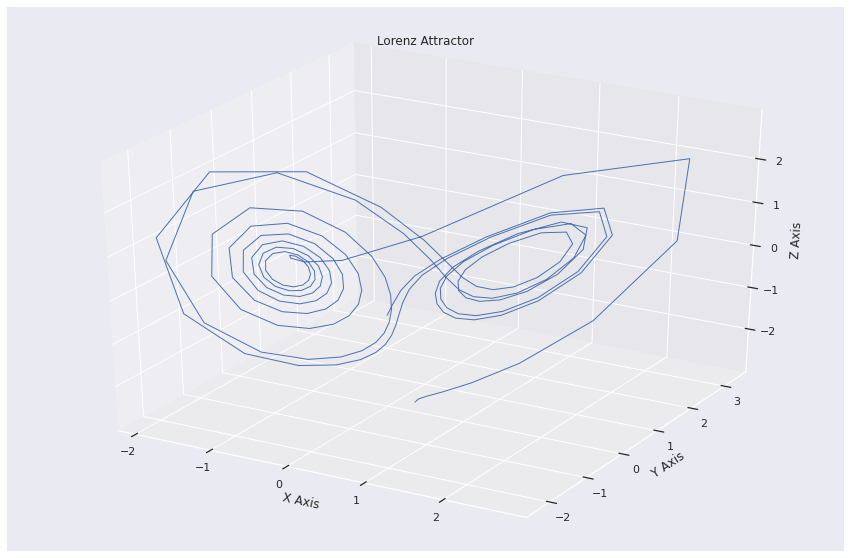

In [320]:
# generate Data
t = 200
p = 3
m = 10
q = 50

ds = 10
n_steps = t * ds - 1

x = lorenz_traj(10, 28, 8/3, dt=0.005, n_steps=n_steps, ds=ds, init=(1, 0, 0))
x = np.array(x)
x = stats.zscore(x, axis=-1)

fig = plt.figure(figsize=(15, 10))
ax = fig.gca(projection='3d')

ax.plot(*x, lw=1)
ax.set_xlabel("X Axis")
ax.set_ylabel("Y Axis")
ax.set_zlabel("Z Axis")
ax.set_title("Lorenz Attractor")

In [341]:
noise_var = 0.001
subject_noise_scale = np.zeros(shape=(m,)) + noise_var ** (1 / 4)
roi_noise_scale = np.zeros(shape=(q,)) + noise_var**(1 / 4)

# subject_noise_scale = np.linspace(2, 10, m)
# roi_noise_scale = np.linspace(1, 5, q)


generator = SharedGpfa(m, q, p, name='Ground Truth', color=colors['other'])
generator.t = [t]
generator.init_vars()
generator.init_joint()
generator.vars['subject_noise_scale'].assign(subject_noise_scale)
generator.vars['roi_noise_scale'].assign(roi_noise_scale)

w_true = generator.joint[0].model['w'].sample().numpy()
x_true = x.astype(generator.dtype)

generator.vars['x'][0].assign(x_true)
generator.vars['w'].assign(w_true)

train_data = generator.joint[0].model['obs'](x_true, w_true).sample().numpy()

L = np.random.normal(scale=0.5, size=(q, q))
_, v = np.linalg.eig(L @ L.T)
cov = v @ np.diag(np.linspace(0.3, 8, q)) @ v.T
train_data += np.random.multivariate_normal(np.zeros(shape=(q,)), cov, size=(m, t)).transpose(0, 2, 1)

16.666666666666664


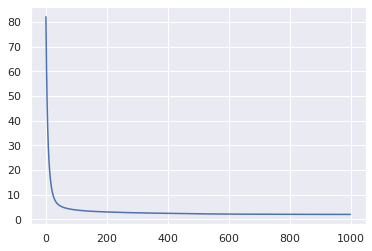

In [342]:
# fit SGPFA
sgpfa = SharedGpfa(m, q, p, color=colors['sgpfa'])
smoothness = 1
sm_factor = 10
reg = 1
loss = sgpfa.fit(
    train_data=[train_data],
    n_iters=1000,
    learning_rate=0.03,
    tensorboard=False,
    fa_init=False,
    reg=reg,
    smoothness=smoothness,
    sm_factor=sm_factor
)
# sgpfa.sort()

plt.plot(loss);

# fit SRM
srm = SRM(n_iter=30, features=p, color=colors['srm'])
srm.fit(train_data)
# srm.sort()

In [344]:
# match dimensions:

for model in (sgpfa, srm):
    corrs = []
    for idx in permutations(range(p)):
        corr = [stats.pearsonr(x_est, x)[0] for x_est, x in zip(model.traj()[idx, :], generator.traj())]
        corrs.append(corr)
    corrs = np.array(corrs)
    best_perm_idx = np.argmax(np.abs(corrs).mean(-1))
    best_perm = list(permutations(range(p)))[best_perm_idx]
    best_perm = np.array(best_perm)
    model.sort(idx=best_perm, sgn=corrs[best_perm_idx])
    print(best_perm, np.abs(corrs[best_perm_idx]).mean())

[0 1 2] 0.8379461603247362
[0 1 2] 0.7543014861514447


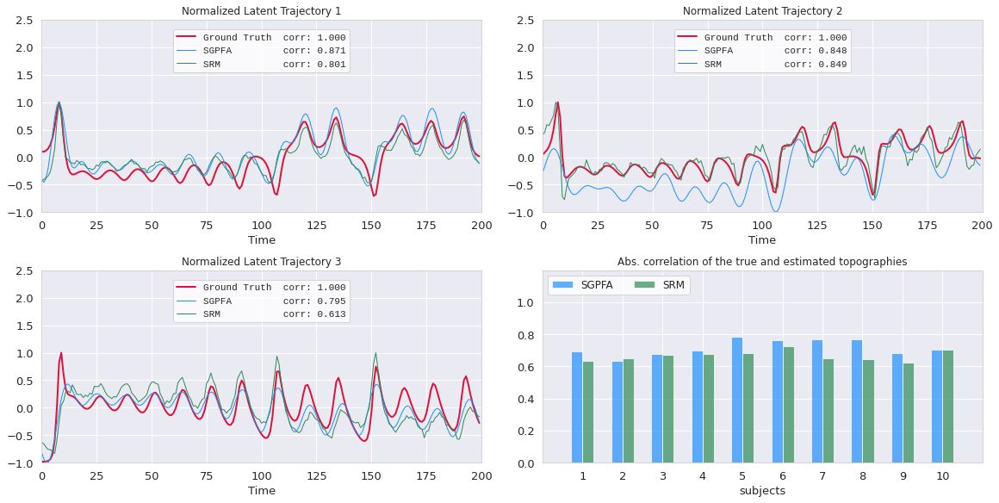

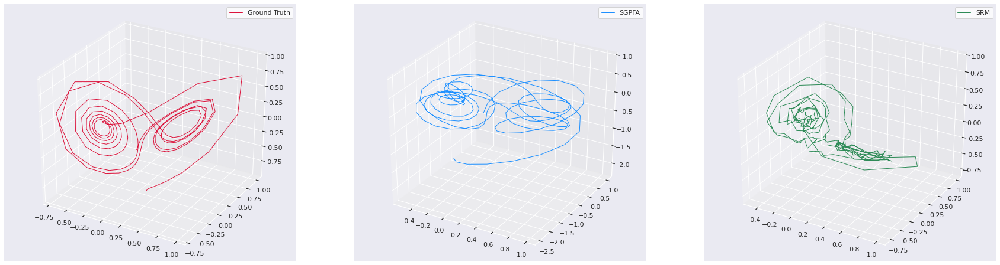

In [345]:
# plot results:

ncols = 2
nrows = 2
fig1, axs = plt.subplots(nrows, ncols, figsize=(16, 4 * nrows), sharex=False, sharey=False, constrained_layout=True)
ptools.spine(fig1)
ptools.font_size(fig1, 13)

for model, lw, a in zip((generator, sgpfa, srm), (2, 1, 1), (1, 1, 1)):
    c = model.color
    for ax, x_est, x_true, i in zip(axs.flat, model.traj(), generator.traj(), range(p)):
        corr = stats.pearsonr(x_est, x_true)[0]
        label = (model.name
                 + " " * (len(generator.name) - len(model.name) + 2)
                 + f'corr: {abs(corr):.3f}')
        ax.plot(np.sign(corr) * x_est / np.abs(x_est).max(), color=c, label=label, lw=lw, alpha=a)
        ax.legend(loc='upper center', borderaxespad=1, prop={'family': 'Liberation Mono'})
        ax.set_xlim(0, t)
        ax.set_ylim(-1, 2.5)
        ax.set_xlabel('Time')
        ax.set_title(f'Normalized Latent Trajectory {i+1}')
        
w = 0.28
for model, offset in zip((sgpfa, srm), (-1, 1)):
    w_true = generator.weights()
    w_est = model.weights()
    r = []
    for _w_est, _w_true in zip(w_est, w_true):
        _r = np.abs(mat_corr(_w_est.T, _w_true.T)).mean()
        r.append(_r)
    axs[1, 1].bar(np.arange(m) + offset * w / 2, r, label=model.name, width=w, color=model.color, alpha=0.7, ec='w')
axs[1, 1].set_xticks(np.arange(0, m, 1))
axs[1, 1].set_xticklabels(np.arange(1, m + 1, 1))
axs[1, 1].set_yticks(np.arange(0, 1.2, .2))
axs[1, 1].set_xlabel('subjects')
axs[1, 1].set_title('Abs. correlation of the true and estimated topographies')
axs[1, 1].set_ylim(0, 1.2)
axs[1, 1].set_xlim(-1, m)
axs[1, 1].legend(fontsize=12, ncol=2, loc='upper left')

fig, axs = plt.subplots(1, 3, figsize=(30, 8), subplot_kw={'projection': '3d'})
for model, ax in zip((generator, sgpfa, srm), axs.flat):
    traj = model.traj() / model.traj().max(-1).reshape(-1, 1)
    ax.plot(*traj, lw=1, label=model.name, color=model.color)
    ax.legend()

# ISC for functional registration (raider dataset)

## Experiment 1:
1st half of the data (all subjects) --> train a model  
2nd half of the data (all subjects) --> map to shared space individually --> find ISC over voxels

In [6]:
# Load raider

tf.random.set_seed(1)
np.random.seed(1)

movie_data = np.load(os.path.join('raider', 'movie.npy'))
movie_data = movie_data.transpose(-1, 0, 1)
movie_data = movie_data[:, :, :500]

train_data, test_data = np.array_split(movie_data, 2, -1)
# train_data = stats.zscore(train_data, axis=-1)
# test_data = stats.zscore(test_data, axis=-1)

m, q, t = train_data.shape

In [8]:
# Load Sherlock

data = np.load(os.path.join('sherlock_h5_data', 'sherlock.npy'))
data = movie_data.transpose(-1, 0, 1)
data = movie_data[:, :, :500]
train_data, test_data = np.array_split(movie_data, 2, -1)
# train_data = stats.zscore(train_data, axis=-1)
# test_data = stats.zscore(test_data, axis=-1)

m, q, t = train_data.shape
print(m, q, t)

10 1000 250


In [138]:
# Load SPINS

tf.random.set_seed(1)
np.random.seed(1)

spins, subdf, score = load_ea_data(vid=[0, 1, 2, 3], filter_subs=True, platform=platform)
for d in spins:
    print(d.shape)

train_data, test_data = spins[:3], spins[-1]
m, q, _ = train_data[0].shape

yeo, label_ticks, label_names = get_atlas_ticks(platform)

(332, 400, 85)
(332, 400, 73)
(332, 400, 55)
(332, 400, 72)


In [ ]:
p_range = np.arange(5, 60, 5)
sm_range = np.array([1, 2, 5, 10, 20, 30, 50, 100, 200, 500])

result = np.zeros(shape=(len(p_range), len(sm_range), 2, test_data.shape[-1]))
for ip, p in enumerate(tqdm(p_range)):
    for ism, sm_factor in enumerate(tqdm(sm_range)):
        print(p, sm_factor)
        
        # fit SGPFA
        tf.random.set_seed(1)
        np.random.seed(1)

        sgpfa = SharedGpfa(m, q, p)
        sm_factor = 20
        smoothness = 1
        reg = 1
        loss = sgpfa.fit(
            train_data=[train_data],
            n_iters=1500,
            learning_rate=0.05,
            tensorboard=False,
            fa_init=False,
            reg=reg,
            smoothness=smoothness,
            sm_factor=sm_factor,
            disable=True)
        sgpfa.sort()
        sgpfa_test = np.array([sgpfa.least_square_traj(d, subs=[s])[0] for s, d in enumerate(test_data)])
        sgpfa_corr = isc(sgpfa_test.transpose(1, 2, 0), pairwise=False, summary_statistic='mean')
        
        # fit SRM
        srm = SRM(n_iter=20, features=p)
        srm.fit(train_data)
        srm.sort()
        srm_test = srm.transform(test_data)
        srm_corr = isc(srm_test.transpose(1, 2, 0), pairwise=False, summary_statistic='mean')

        result[ip, ism, 0, :] = sgpfa_corr
        result[ip, ism, 1, :] = srm_corr
        np.savez('isc', result=result, p_range=p_range, sm_range=sm_range)

Instructions for updating:
Do not pass `graph_parents`.  They will  no longer be used.



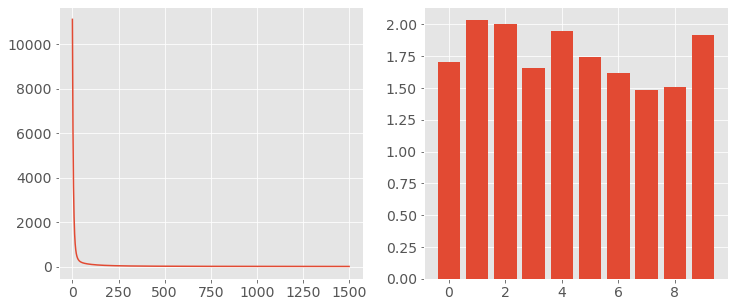

In [9]:
p = 10

# fit SGPFA
sgpfa = SharedGpfa(m, q, p)
sm_factor = None
smoothness = 200
reg = 1
loss = sgpfa.fit(
    train_data=train_data,
    n_iters=1500,
    learning_rate=0.05,
    tensorboard=False,
    fa_init=False,
    reg=reg,
    smoothness=smoothness,
    sm_factor=sm_factor
)
# sgpfa.sort()
_, axs = plt.subplots(1, 2, figsize=(12, 5))
axs[0].plot(loss)
axs[1].bar(np.arange(p), sgpfa.len_scale())

# fit SRM
srm = SRM(n_iter=20, features=p)
srm.fit(train_data)
# srm.sort()

# fit RSRM
rsrm = RSRM(n_iter=10, features=p)
rsrm.fit(train_data)


In [10]:
# srm_train = srm.transform(train_data)
# sgpfa_train = np.array([sgpfa.least_square_traj(d, subs=[s])[0] for s, d in enumerate(train_data)])

srm_test = srm.transform(test_data)
rsrm_test, _ = rsrm.transform(test_data)


sgpfa_test = np.array([sgpfa.least_square_traj(d, subs=[s])[0] for s, d in enumerate(test_data)])
smoothness = (q / p) / 10
# smoothness = 100
# sgpfa_test = np.array([
#     sgpfa.add_video_subjects(d, smoothness=smoothness, n_iters=1200, learning_rate=0.05, subs=[s], disable=True)[0].numpy()
#     for s, d in enumerate(tqdm(test_data))
# ])


(0.0, 62.0)

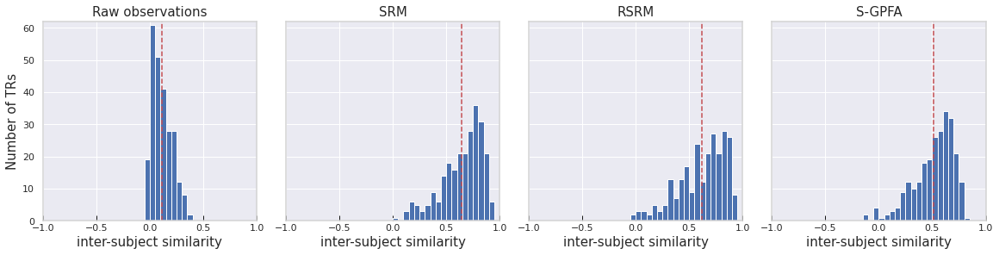

In [13]:
fig, axs = plt.subplots(1, 4, figsize=(16, 4), sharex=True, sharey=True, constrained_layout=True)
sns.set()
for data, ax, label in zip((test_data, srm_test, rsrm_test, sgpfa_test), axs.flat, ('Raw observations', 'SRM', 'RSRM', 'S-GPFA')):
    corr = isc(data.transpose(1, 2, 0), pairwise=False, summary_statistic='mean')
#     corr = isc(data.transpose(2, 1, 0), pairwise=False, summary_statistic='mean')

#     x = np.arctanh(corr)
    x = corr
    ax.hist(x, label=label, bins=np.arange(-1, 1, 0.05), density=False, color='b')
#     sns.distplot(x, kde=False, rug=False, hist=True, ax=ax)
    ax.axvline(x.mean(), ls='--', color='r')
    ax.set_xlim(-1, 1)
    ax.set_ylabel('Number of TRs', fontsize=15)
#     xlabel = 'correlation across ' + ('voxels' if label == 'Raw observations' else 'latent dimensions')
    xlabel = 'inter-subject similarity'
    ax.set_xlabel(xlabel, fontsize=15)
    ax.set_xticks(np.arange(-1, 1.5, 0.5))
    ax.set_title(label, fontsize=15)
    ax.tick_params(axis='x', bottom=True, direction='in', width=1, length=6, color='k')
plt.setp(axs[1:], 'ylabel', '')
ptools.spine(fig)

ax.set_ylim(0, 62)
# corr = isc(sgpfa_test300.transpose(1, 2, 0), pairwise=False, summary_statistic='mean')
# ax.hist(corr, label=label, bins=np.arange(-1, 1, 0.05), color='r', alpha=0.5)
# ax.axvline(corr.mean(), ls='--', color='r')

In [ ]:
# This generates the fig:

p = 10
sm_factor = None
smoothness = 200
reg = 1
sgpfa = SharedGpfa(m, q, p)
loss = sgpfa.fit(
    train_data=train_data,
    n_iters=1500,
    learning_rate=0.05,
    tensorboard=False,
    fa_init=False,
    reg=reg,
    smoothness=smoothness,
    sm_factor=sm_factor
)
sgpfa_test = np.array([sgpfa.least_square_traj(d, subs=[s])[0] for s, d in enumerate(test_data)])


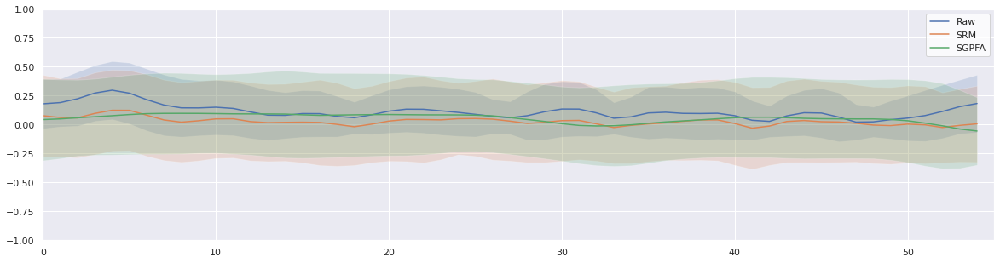

In [137]:
fig, ax = plt.subplots(figsize=(20, 5))
for data, label in zip((test_data, srm_test, sgpfa_test), ('Raw', 'SRM', 'SGPFA')):
    corr = isc(data.transpose(1, 2, 0), pairwise=False, summary_statistic=None)
    ax.plot(corr.mean(0), label=label)
    ax.fill_between(np.arange(corr.shape[-1]), corr.mean(0) + corr.std(0), corr.mean(0) - corr.std(0), alpha=0.2)
    ax.set_xlim(0, corr.shape[-1])
    ax.set_ylim(-1, 1)
    ax.legend()

## Experiment 2
split subjects to 2 groups. For each group:  
1st half --> train a model   
2nd half --> map back to the shared space (using all subjects)   
find the ISC over voxels between two group's shared responses.

In [81]:
# Load raider

tf.random.set_seed(1)
np.random.seed(1)

movie_data = np.load(os.path.join('raider', 'movie.npy'))
movie_data = movie_data.transpose(-1, 0, 1)
movie_data = movie_data[:, :, :1000]

In [82]:
p = 40
smoothness = 10
sm_factor = 25
reg = 1

data = np.array_split(movie_data, 2, 0)
raw = []
srm_shared = []
sgpfa_shared = []
for g in range(2):
    data[g] = np.array_split(data[g], 2, -1)
    m, q, t = data[g][0].shape
    
    # Raw
    raw.append(data[g][1].mean(0))
    
    # SRM
    srm = SRM(n_iter=20, features=p)
    srm.fit(data[g][0])
    srm.sort()
    _srm_shared = srm.transform(data[g][1])
    _srm_shared = np.array(_srm_shared).mean(0)
    srm_shared.append(_srm_shared)

    
    # SGPFA
    sgpfa = SharedGpfa(m, q, p)
    loss = sgpfa.fit(
        train_data=[data[g][0]],
        n_iters=1500,
        learning_rate=0.05,
        tensorboard=False,
        fa_init=False,
        reg=reg,
        smoothness=smoothness,
        sm_factor=sm_factor)
    sgpfa.sort()
    
#     _sgpfa_shared = sgpfa.add_video(obs=data[g][1],
#                                     ls_init=False,
#                                     learning_rate=0.05,
#                                     smoothness=smoothness,
#                                     sm_factor=sm_factor,
#                                     n_iters=1000)
#     _sgpfa_shared = _sgpfa_shared[0].numpy()
    
    _sgpfa_shared = sgpfa.least_square_traj(data[g][1], subs=Ellipsis)[0]
    sgpfa_shared.append(_sgpfa_shared)

raw = np.array(raw)
srm_shared = np.array(srm_shared)
sgpfa_shared = np.array(sgpfa_shared)

# register for 180 rotation
srm_shared[0, ...] *= np.sign(isc(srm_shared.transpose(2, 1, 0), pairwise=True)).reshape(-1, 1)
sgpfa_shared[0, ...] *= np.sign(isc(sgpfa_shared.transpose(2, 1, 0), pairwise=True)).reshape(-1, 1)

In [101]:
# Load SPINS

tf.random.set_seed(1)
np.random.seed(1)

spins, subdf, score = load_ea_data(vid=[0, 1], filter_subs=True, platform=platform)
for d in spins:
    print(d.shape)

train_data, test_data = spins
    
yeo, label_ticks, label_names = get_atlas_ticks(platform)

(332, 400, 85)
(332, 400, 73)


In [102]:
p = 10
smoothness = 10
sm_factor = 25
reg = 1

raw = []
srm_shared = []
sgpfa_shared = []

m = train_data.shape[0]
idx = np.arange(m)
np.random.shuffle(idx)

for g in np.array_split(idx, 2):
    
    m, q, t = train_data[g].shape
    
    # Raw
    raw.append(test_data[g].mean(0))
    
    # SRM
    srm = SRM(n_iter=20, features=p)
    srm.fit(train_data[g])
    srm.sort()
    _srm_shared = srm.transform(test_data[g])
    _srm_shared = np.array(_srm_shared).mean(0)
    srm_shared.append(_srm_shared)

    
    # SGPFA
    sgpfa = SharedGpfa(m, q, p)
    loss = sgpfa.fit(
        train_data=[train_data[g]],
        n_iters=1500,
        learning_rate=0.05,
        tensorboard=False,
        fa_init=False,
        reg=reg,
        smoothness=smoothness,
        sm_factor=sm_factor)
    sgpfa.sort()
    
#     _sgpfa_shared = sgpfa.add_video(obs=data[g][1],
#                                     ls_init=False,
#                                     learning_rate=0.05,
#                                     smoothness=smoothness,
#                                     sm_factor=sm_factor,
#                                     n_iters=1000)
#     _sgpfa_shared = _sgpfa_shared[0].numpy()
    
    _sgpfa_shared = sgpfa.least_square_traj(test_data[g], subs=Ellipsis)[0]
    sgpfa_shared.append(_sgpfa_shared)

raw = np.array(raw)
srm_shared = np.array(srm_shared)
sgpfa_shared = np.array(sgpfa_shared)

# register for 180 rotation
srm_shared[0, ...] *= np.sign(isc(srm_shared.transpose(2, 1, 0), pairwise=True)).reshape(-1, 1)
sgpfa_shared[0, ...] *= np.sign(isc(sgpfa_shared.transpose(2, 1, 0), pairwise=True)).reshape(-1, 1)

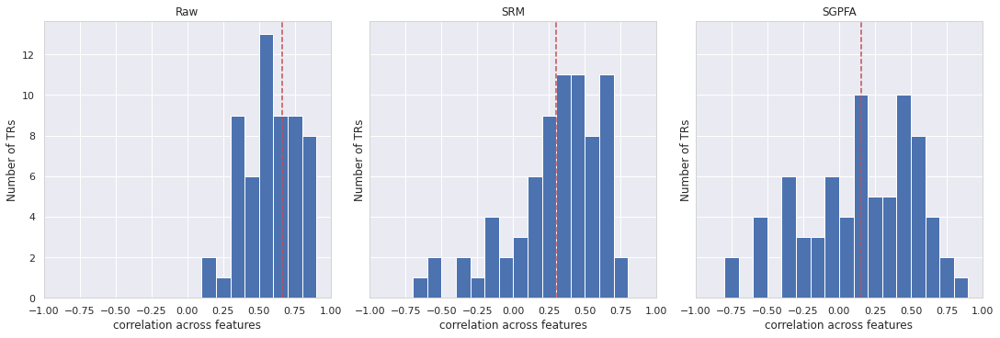

In [103]:
fig, axs = plt.subplots(1, 3, figsize=(15, 5), sharex=True, sharey=True, constrained_layout=True)
ptools.spine(fig)
for data, ax, label in zip((raw, srm_shared, sgpfa_shared), axs.flat, ('Raw', 'SRM', 'SGPFA')):
    corr = isc(data.transpose(1, 2, 0))
    x = corr
#     x = np.arctanh(corr)
    ax.hist(x, label=label, bins=np.arange(-1, 1, 0.1))
    ax.axvline(x.mean(), ls='--', color='r')
    ax.set_title(label)
    ax.set_xlim(-1, 1)
    ax.set_ylabel('Number of TRs')
    ax.set_xlabel('correlation across features')

# Time-segment matching

In [50]:
# Take in a list of participants of voxel by TR data. Also specify how big the time segment is to be matched
def correlation_classifier(train, test, win_size):
    if train.ndim == 2:
        train = np.expand_dims(train, 0)
        
    nsubjs = len(train)
    (ndim, nsample) = train[0].shape
    nseg = nsample - win_size + 1

    # mysseg prediction
    trn_data = np.zeros((ndim * win_size, nseg), order='f')
    
    for m in range(nsubjs):
        for w in range(win_size):
            trn_data[w * ndim:(w + 1) * ndim, :] += train[m][:, w:(w + nseg)]
    trn_data = trn_data / nsubjs
    
    tst_data = np.zeros((ndim * win_size, nseg), order='f')
    for w in range(win_size):
        tst_data[w * ndim:(w + 1) * ndim, :] = test[:, w:(w + nseg)]

    # compute correlation matrix
    corr_mtx = compute_correlation(trn_data.T, tst_data.T)

    # The correlation classifier.
    for i in range(nseg):
        for j in range(nseg):
            # exclude segments overlapping with the testing segment
            if abs(i - j) < win_size and i != j:
                corr_mtx[i, j] = - np.inf
    max_idx = np.argmax(corr_mtx, axis=1)
    accu = sum(max_idx == range(nseg)) / nseg
    return accu


def time_segment_matching(half1, half2, n_features=30, win_size=10, sm=20, desc=''):
    if type(win_size) is int:
        win_size = [win_size]
    loo = LeaveOneOut()
    df = pd.DataFrame(columns=['acc', 'method', 'win'])
    
    pbar = tqdm(loo.split(half1), total=loo.get_n_splits(half1), desc=desc)
    for train_subs, test_sub in pbar:
        test_sub = test_sub[0]

        # no functional registration
        pbar.set_description(f'{desc} Raw')
        pbar.refresh()
        # time-segment matching performance
        for w in win_size:
            acc = correlation_classifier(half2[train_subs], half2[test_sub], w)
            df = df.append({'acc': acc, 'method': 'Raw', 'win': w}, ignore_index=True)

        # Shared Response Model
        pbar.set_description(f'{desc} SRM')
        pbar.refresh()
        # fit srm using half1[train_subs]
        srm = SRM(n_iter=20, features=n_features, rand_seed=10)
        srm.fit(half1[train_subs])
        # find the held-out subject weights using half1[test_sub]
        w_test_sub = srm.transform_subject(half1[test_sub])
        # map half2[train_subs] to shared space
        half2_shared_train = srm.transform(half2[train_subs])
        # map held-out subject half2 to shared space
        half2_shared_test = w_test_sub.T.dot(half2[test_sub])
        # time-segment matching performance        
        for w in win_size:
            acc = correlation_classifier(half2_shared_train, half2_shared_test, w)
            df = df.append({'acc': acc, 'method': 'SRM', 'win': w}, ignore_index=True)
        
        # Robust Shared Response Model
        pbar.set_description(f'{desc} RSRM')
        pbar.refresh()
        # fit srm using half1[train_subs]
        rsrm = RSRM(n_iter=20, features=n_features, rand_seed=10)
        rsrm.fit(half1[train_subs])
        # find the held-out subject weights using half1[test_sub]
        w_test_sub, _ = rsrm.transform_subject(half1[test_sub])
        # map half2[train_subs] to shared space
        half2_shared_train, _ = rsrm.transform(half2[train_subs])
        # map held-out subject half2 to shared space
        half2_shared_test = w_test_sub.T.dot(half2[test_sub])
        # time-segment matching performance
        for w in win_size:
            acc = correlation_classifier(half2_shared_train, half2_shared_test, w)
            df = df.append({'acc': acc, 'method': 'RSRM', 'win': w}, ignore_index=True)

        
        # adapt smoothness and reg for add_video, add_subject
        
        # Shared GPFA
        pbar.set_description(f'{desc} SGPFA')
        pbar.refresh()
        # fit sgpfa using half1[train_subs]
        sgpfa = SharedGpfa(len(train_subs), half1.shape[1], n_features)
        sgpfa.fit(train_data=half1[train_subs], n_iters=1000, learning_rate=0.07, sm_factor=sm, fa_init=False, reg=1)
        # map half2[train_subs] to shared space
        half2_shared_train = sgpfa.add_video(half2[train_subs], n_iters=1000, learning_rate=0.07, sm_factor=sm, ls_init=False, desc='mapping 2nd half for train')
        half2_shared_train = half2_shared_train[0].numpy()
        # find the held-out subject base using half1[test_sub]
        w_test_sub = sgpfa.add_subject(half1[test_sub], add_to_model=True, solve_ls=True, reg=1)
        # map held-out subject half2 to shared space
        # TODO: what about the noise variance for the treaining subject?
        # half2_shared_test = w_test_sub.T.dot(half2[test_sub])
        smoothness = (sgpfa.q / sgpfa.p) / sm
        half2_shared_test = sgpfa.add_video_subjects(half2[test_sub], n_iters=1000, learning_rate=0.07, smoothness=smoothness, ls_init=False, subs=sgpfa.m - 1, desc='mapping 2nd half for test')
        half2_shared_test = half2_shared_test[0].numpy()
        # time-segment matching performance
        for w in win_size:
            acc = correlation_classifier(half2_shared_train, half2_shared_test, w)
            df = df.append({'acc': acc, 'method': 'S-GPFA', 'win': w}, ignore_index=True)
            
    return df

In [51]:
# Load raider
movie_data = np.load(os.path.join('raider', 'movie.npy'))
movie_data = movie_data.transpose(-1, 0, 1)

half1, half2 = np.array_split(movie_data, 2, -1)
half1 = stats.zscore(half1, axis=-1)
half2 = stats.zscore(half2, axis=-1)

In [54]:
p = 10
sm = 10
win_size = np.array([3, 5, 10, 20, 25, 30])
n_subs = 10
n_trs = 200

half1 = half1[:n_subs, :, :n_trs]
half2 = half2[:n_subs, :, :n_trs]

tsm_df = time_segment_matching(half1, half2, n_features=p, win_size=win_size, sm=sm)


30.0



30.0



30.0



30.0


Text(0, 0.5, 'Accuracy')

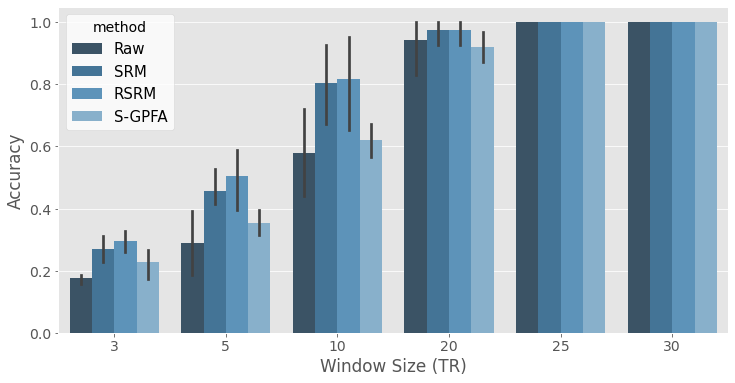

In [55]:
fig, ax = plt.subplots(figsize=(12, 6))
sns.barplot(x="win", y="acc", hue="method", data=tsm_df, palette='Blues_d', ax=ax)
ax.set_xlabel('Window Size (TR)')
ax.set_ylabel('Accuracy')

In [18]:
n_subs = 10
n_trs = 200

half1 = half1[:n_subs, :, :n_trs]
half2 = half2[:n_subs, :, :n_trs]
win_size = np.array([3, 5, 10, 20, 25, 30])
sm_range = np.array([1, 2, 5, 10, 25, 50, 100, 200])
p_range = np.arange(5, 50, 5)
# [p, sm, (acc_g, acc_s, acc_r), test_sub, win_size]
result = np.zeros((len(p_range), len(sm_range), 3, half1.shape[0], len(win_size)))
for ip, p in enumerate(p_range):
    for ism, sm in enumerate(sm_range):
        print('started: ', p, sm)
        acc_g, acc_s, acc_r, acc_rs = time_segment_matching(half1, half2, n_features=p, win_size=win_size, sm=sm)
        result[ip, ism, ...] = acc_g, acc_s, acc_r
        np.save('tsm4', result)
#         print(f'The average accuracy among all subjects using SGPFA is:  {acc_g.mean(0)} +/- {acc_g.std(0)}')
#         print(f'The average accuracy among all subjects using SRM is:    {acc_s.mean(0)} +/- {acc_s.std(0)}')
#         print(f'The average accuracy among all subjects using RAW is:    {acc_r.mean(0)} +/- {acc_r.std(0)}')

started:  5 1


TqdmKeyError: "Unknown argument(s): {'subs': 9}"

Plot Results

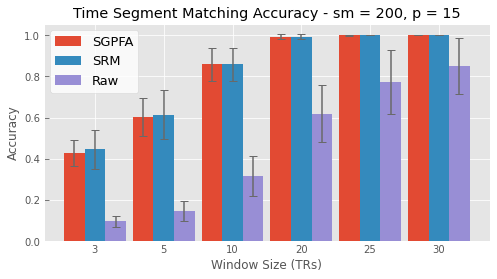

In [16]:
sm = 200
p = 15
acc_full = np.load('tsm3.npy')

acc = acc_full[np.where(p_range==p)[0][0], np.where(sm_range==sm)[0][0], :, :, :]
fig, ax = plt.subplots(figsize=(8, 4))
width = 0.3
for _acc, label, pos in zip(acc, ('SGPFA', 'SRM', 'Raw'), (-1, 0, 1)):
    ax.bar(np.arange(len(win_size)) + pos * width, _acc.mean(0), yerr=_acc.std(0), capsize=4, ecolor='dimgray', label=label, width=width)
ax.set_xlabel('Window Size (TRs)')
ax.set_ylabel('Accuracy')
ax.set_title(f'Time Segment Matching Accuracy - sm = {sm}, p = {p}')
ax.set_xticks(np.arange(len(win_size)))
ax.set_xticklabels(win_size)
ax.legend()

In [28]:
for i, w in enumerate(win_size):
    acc = acc_full[:, :, 0, :, i].mean(-1)
    best_p, best_sm = np.unravel_index(np.argmax(acc, axis=None), acc.shape)
    best_acc = acc[best_p, best_sm]
    best_acc_srm = acc_full[:, :, 1, :, i].mean(-1).max()
    print(f'{w}: \t {p_range[best_p]} \t {sm_range[best_sm]} \t  {best_acc: .3f} \t {best_acc_srm: .3f} ')



3: 	 15 	 50 	   0.436 	  0.460 
5: 	 15 	 50 	   0.612 	  0.618 
10: 	 15 	 50 	   0.862 	  0.866 
20: 	 5 	 200 	   0.993 	  0.992 
25: 	 5 	 100 	   1.000 	  1.000 
30: 	 5 	 100 	   1.000 	  1.000 


# SPINS Data

In [35]:
# Load data

train_data, subdf, score = load_ea_data(vid=[0, 1, 2], filter_subs=True, platform=platform)
for d in train_data:
    print(d.shape)
    
yeo, label_ticks, label_names = get_atlas_ticks(platform)

(332, 400, 85)
(332, 400, 73)
(332, 400, 55)


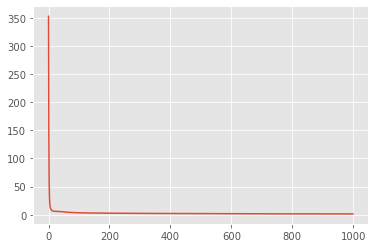

In [35]:
m, q, _ = train_data[0].shape
p = 20

reg = 1
smoothness = (m * q / p) / 10

sgpfa = SharedGpfa(m, q, p)
loss = sgpfa.fit(
    train_data=train_data,
    n_iters=1000,
    learning_rate=0.08,
    tensorboard=False,
    fa_init=False,
    reg=reg,
    smoothness=smoothness)

sgpfa.sort()

plt.plot(loss);

In [36]:
# SRM
srm = SRM(n_iter=20, features=p)
srm.fit(train_data)
srm.sort()

## BIC

In [112]:
train_data, subdf, score = load_ea_data(vid=[0, 1], filter_subs=True, platform=platform)

p_range = np.arange(5, 85, 5)
reg = 1
sm_factor = 10
smoothness = 1

result = np.zeros(shape=(len(p_range), 4))

for ip, p in enumerate(tqdm(p_range)):
    tf.random.set_seed(1)
    np.random.seed(1)

    m, q, _ = train_data[0].shape

    sgpfa = SharedGpfa(m, q, p)
    loss = sgpfa.fit(
        train_data=train_data,
        n_iters=1200,
        learning_rate=0.05,
        tensorboard=False,
        fa_init=False,
        reg=reg,
        sm_factor=sm_factor,
        smoothness=smoothness)
    sgpfa.sort()
    
    bic = sgpfa.bic(train_data)
    bic_joint = sgpfa.bic_joint(train_data)
    modified_bic = sgpfa.modified_bic(train_data)
    aic = sgpfa.aic(train_data)
    
    result[ip, :] = [bic, bic_joint, modified_bic, aic]
    np.savez('bic', result=result, p_range=p_range)

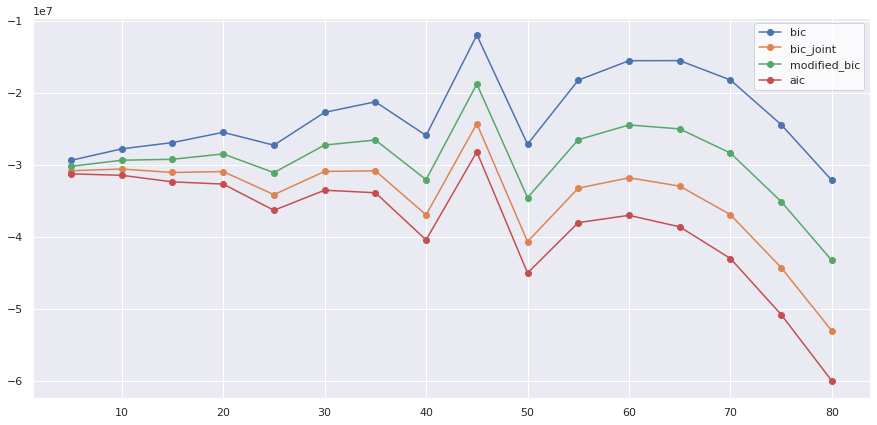

In [129]:
bic = np.load('bic.npz')
result, p_range = bic['result'], bic['p_range']
fix, ax = plt.subplots(figsize=(15, 7))
for i, label in enumerate(['bic', 'bic_joint', 'modified_bic', 'aic']):
    ax.plot(p_range, result[:, i], marker='o', label=label)
    ax.legend()

## Learned Model Parameters

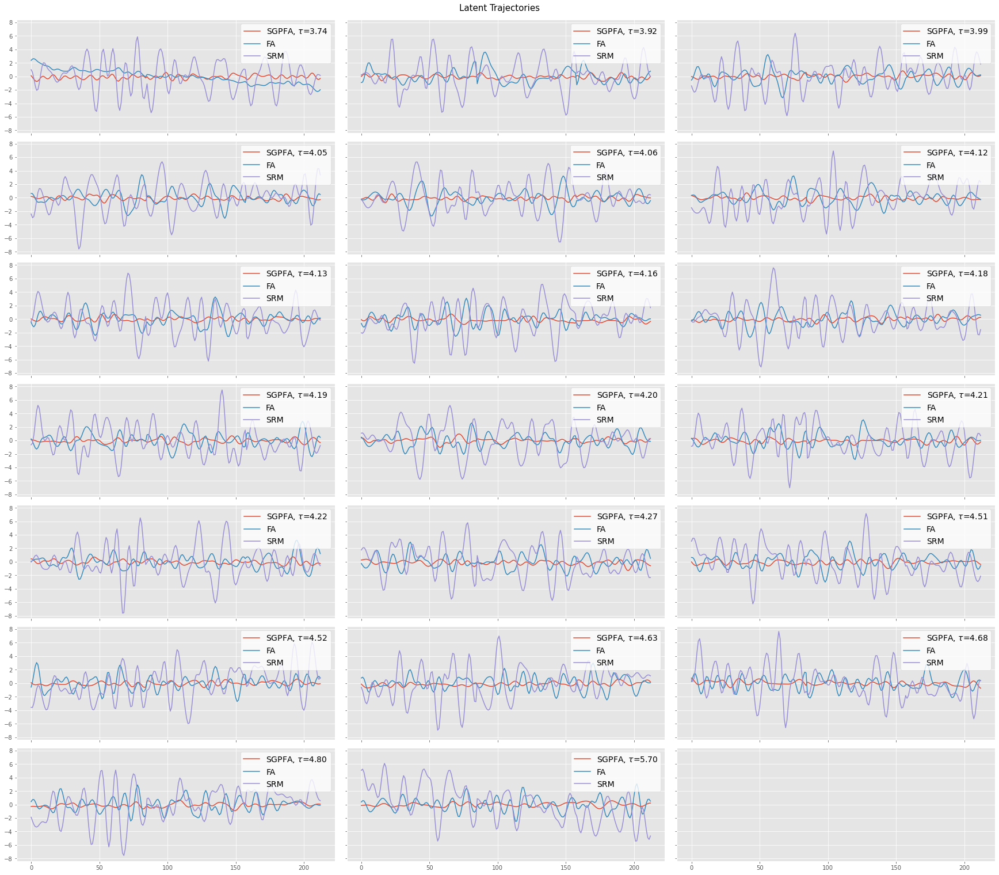

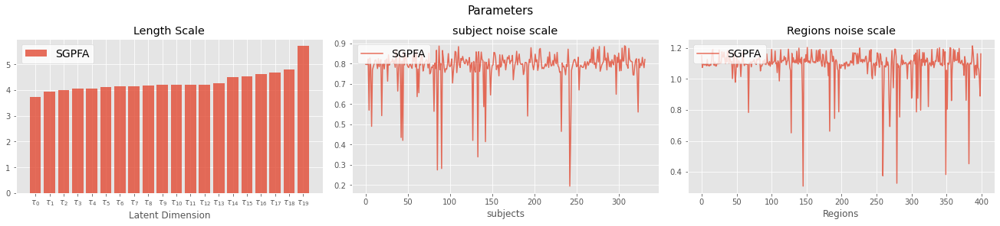

In [50]:
xfa, _ = sgpfa.factor_analysis(train_data)
xfa = np.concatenate(xfa, axis=-1)

ncols = 4
nrows = math.ceil(sgpfa.p / ncols)
fig, axs = plt.subplots(nrows, ncols, figsize=(8 * ncols, 3 * nrows), sharex=True, sharey=True, constrained_layout=True)
fig.suptitle('Latent Trajectories', fontsize=15)

for x_sgpfa, x_fa, x_srm, tau, ax in zip(sgpfa.traj('all'), xfa, srm.traj(), sgpfa.len_scale(), axs.flat):
    ax.plot(x_sgpfa, label=fr'SGPFA, $\tau$={tau:.2f}')
    ax.plot(x_fa, label='FA')
    ax.plot(x_srm, label='SRM')
    ax.legend(loc=1)

# Model Parameters
fig, axs = plt.subplots(1, 3, figsize=(18, 4), constrained_layout=True)
fig.suptitle('Parameters', fontsize=15)
    
axs[0].set_title('Length Scale')
axs[0].bar(np.arange(p), sgpfa.len_scale(), alpha=0.8, label=sgpfa.name)
axs[0].set_xlabel('Latent Dimension')
axs[0].legend(loc=2)
axs[0].set_xticks(np.arange(p))
axs[0].set_xticklabels([fr'$\tau_{{{i}}}$' for i in range(p)])

axs[1].set_title('subject noise scale')
axs[1].plot(np.arange(m), sgpfa.sub_noise(), label=sgpfa.name, alpha=0.8)
axs[1].set_xlabel('subjects')
axs[1].legend(loc=2)
# axs[1].set_xticks(np.arange(m))
# axs[1].set_xticklabels(np.arange(m))

axs[2].set_title('Regions noise scale')
axs[2].plot(np.arange(q), sgpfa.reg_noise(), label=sgpfa.name, alpha=0.8)
axs[2].set_xlabel('Regions')
axs[2].legend(loc=2);
# axs[2].set_xticks(np.arange(q))
# axs[2].set_xticklabels(np.arange(q))

# axs[3].set_title('overal observation noise scale')
# noise = sgpfa.sub_noise()[:, None] * sgpfa.reg_noise()
# axs[3].plot(noise.reshape(-1), label=sgpfa.name)
# axs[3].set_xlabel('Subjects/Regions')
# axs[3].legend(loc=2)
# axs[3].set_xticks(np.arange(0, m * q, q))
# axs[3].set_xticks(np.arange(m * q), minor=True)
# axs[3].set_xticklabels(np.arange(m));

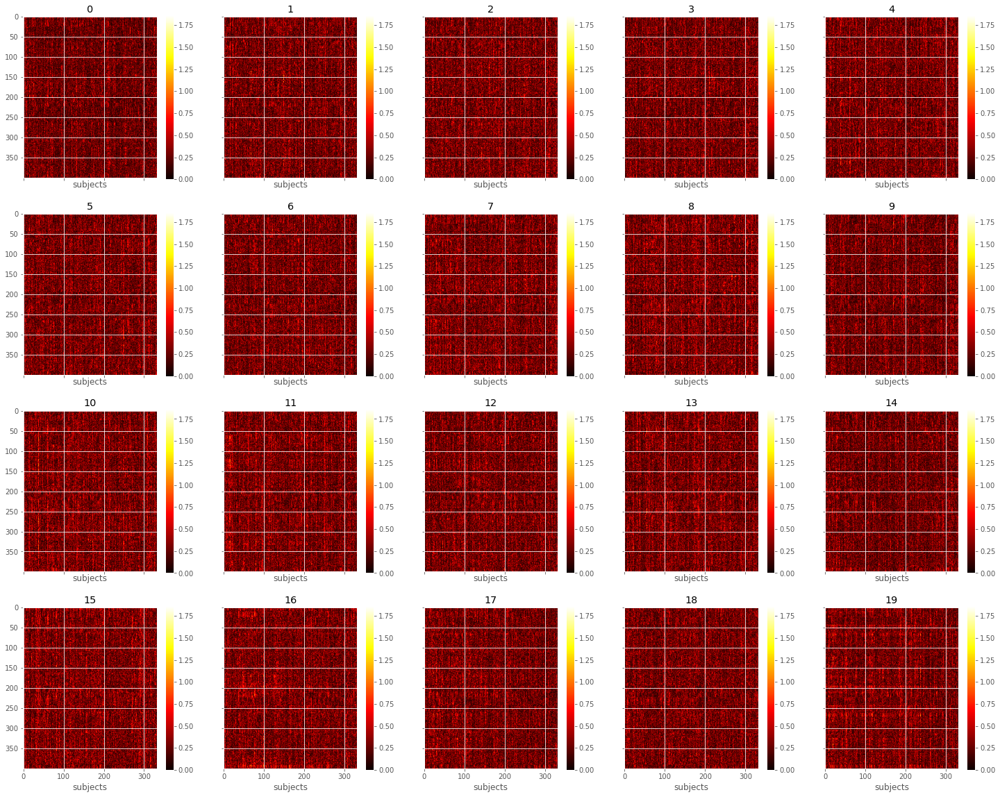

In [15]:
# Plot weights

w = sgpfa.weights()
# w = srm.weights()

ncols = 5
nrows = math.ceil(p / ncols)

fig, axs = plt.subplots(nrows, ncols, figsize=(ncols*5, nrows*5), sharex=True, sharey=True)

vmax = w.max()
for _w, ax, comp in zip(w.transpose((2,1,0)), axs.flat, np.arange(p)):
    im = ax.imshow(np.abs(_w), cmap='hot', vmin=0, vmax=vmax)
    ax.set_title(comp)
    fig.colorbar(im, ax=ax)
    ax.set_xlabel('subjects')

## Reconstruction

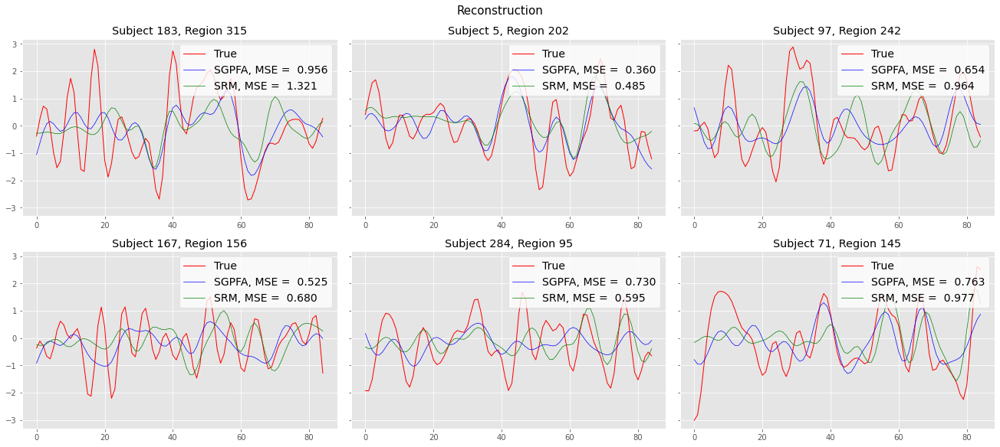

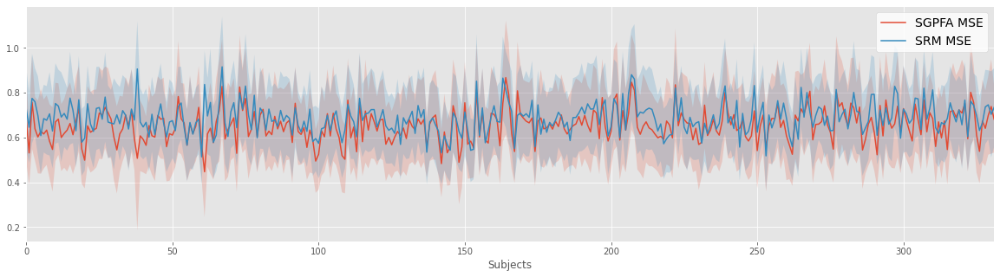

In [21]:
# Reconstruction
ncols = 3
nrows = 2
fig, axs = plt.subplots(nrows, ncols, figsize=(18,8), sharex=False, sharey=True, constrained_layout=True)
fig.suptitle('Reconstruction', fontsize=15)

for ax in axs.flat:
    sub = np.random.randint(m)
    reg = np.random.randint(q)
    y_true = train_data[0][sub, reg, :]
    ax.plot(y_true, color='r', label='True', lw=1)
    for model, c in zip((sgpfa, srm), ('b', 'g')):
        y_est = (model.weights() @ model.traj())[sub, reg, :train_data[0].shape[-1]]
        label = f'{model.name}, MSE = {np.mean((y_true - y_est)**2): .3f}'
        ax.plot(y_est, color=c, label=label, lw=0.7)
    ax.set_title(f'Subject {sub}, Region {reg}')
    ax.legend(loc=1)


def mse(y_true, y_hat):
    se = (y_true - y_hat) ** 2
    mse = se.mean(-1)
    return mse, mse.mean(-1), mse.std(-1)


fig, ax = plt.subplots(figsize=(20, 5))
for model in (sgpfa, srm):
    y_est = (model.weights() @ model.traj())[:, :, :train_data[0].shape[-1]]
    _, mse_mean, mse_std = mse(train_data[0], y_est)
    ax.plot(mse_mean, label=f'{model.name} MSE')
    ax.fill_between(np.arange(m), mse_mean - mse_std, mse_mean + mse_std, alpha=0.2)
ax.legend()
ax.set_xlim(0, m-1)
ax.set_xlabel('Subjects');

## Add a new video to model

In [22]:
valid = load_ea_data(vid=[3], filter_subs=True, platform=platform)[0]

xlist_sgpfa = sgpfa.add_video(valid,
                        n_iters=1000,
                        learning_rate=0.05,
                        smoothness=smoothness,
                        tensorboard=False,
                        ls_init=False)
x_sgpfa = xlist_sgpfa[0].numpy()

x_srm = srm.transform(valid)
x_srm = np.stack(x_srm, 0).mean(0)

x_pinv = sgpfa.least_square_traj(valid)[0]

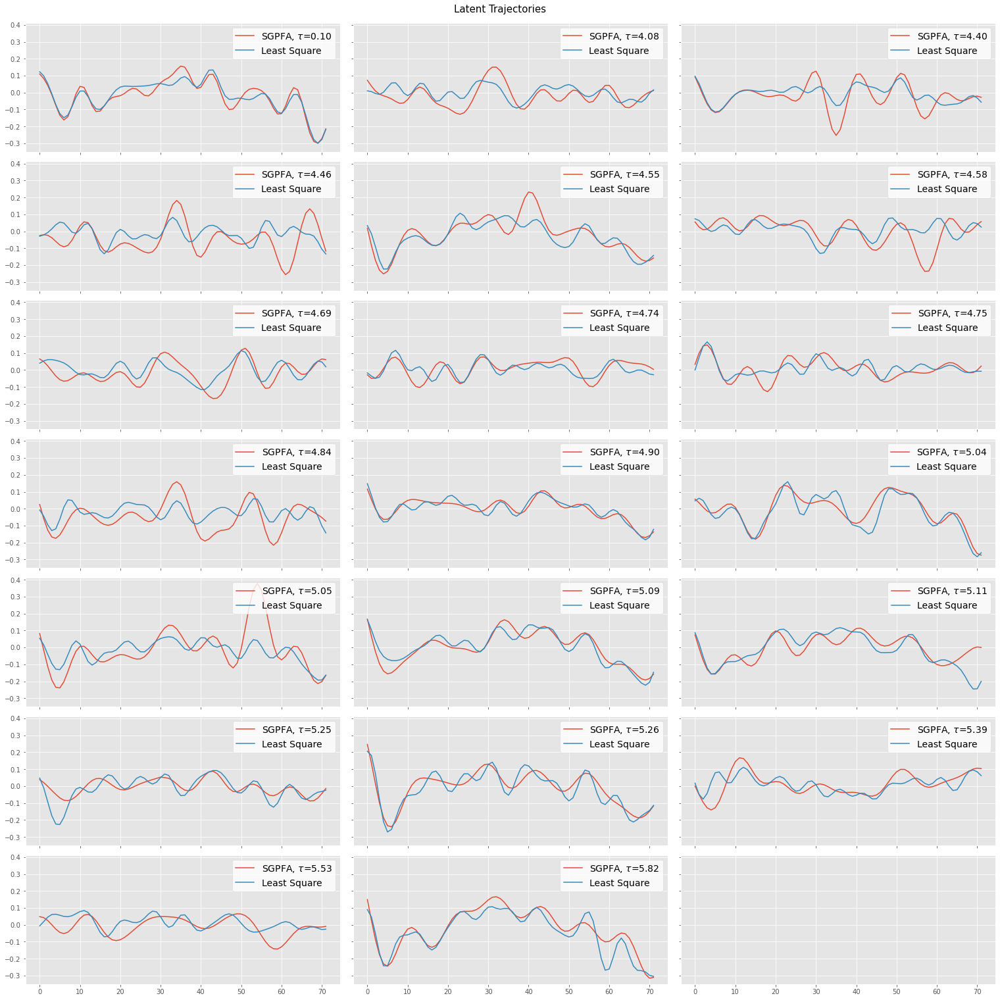

In [24]:
ncols = 3
nrows = math.ceil(sgpfa.p / ncols)
fig, axs = plt.subplots(nrows, ncols, figsize=(7 * ncols, 3 * nrows), sharex=True, sharey=True, constrained_layout=True)
fig.suptitle('Latent Trajectories', fontsize=15)
for _x_sgpfa, _x_pinv, _x_srm, tau, ax in zip(x_sgpfa, x_pinv, x_srm, sgpfa.len_scale(), axs.flat):
    ax.plot(_x_sgpfa, label=fr'SGPFA, $\tau$={tau:.2f}')
    ax.plot(_x_pinv, label='Least Square')
#     ax.plot(x_srm, label='SRM')
    ax.legend(loc=1)

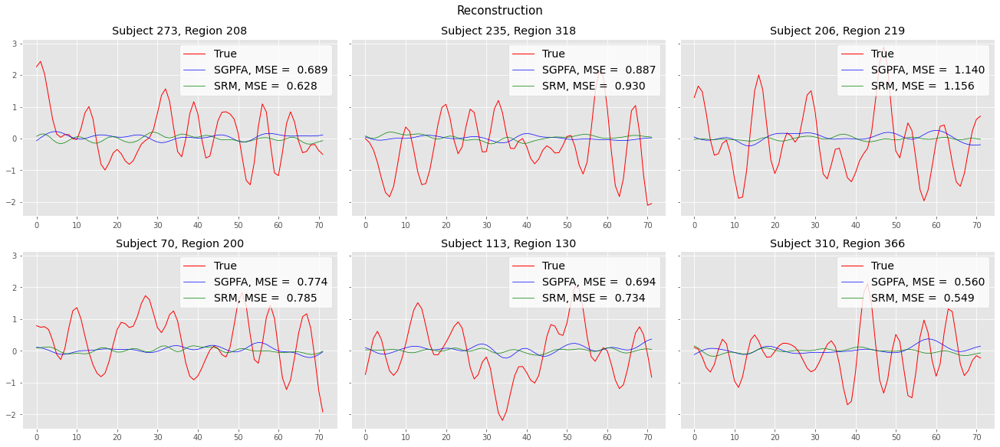

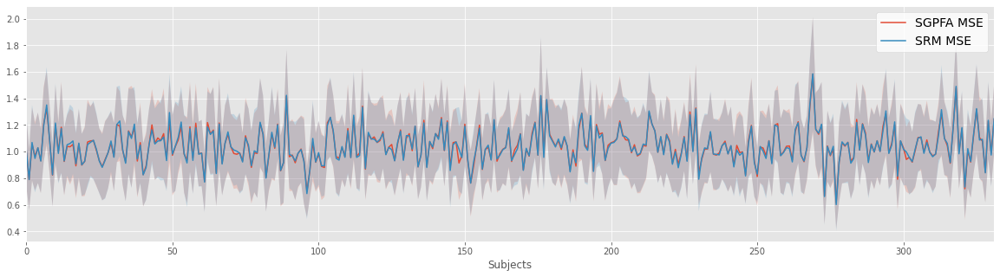

In [27]:
# Reconstruction
ncols = 3
nrows = 2
fig, axs = plt.subplots(nrows, ncols, figsize=(18,8), sharex=False, sharey=True, constrained_layout=True)
fig.suptitle('Reconstruction', fontsize=15)

for ax in axs.flat:
    sub = np.random.randint(m)
    reg = np.random.randint(q)
    y_true = valid[0][sub, reg, :]
    ax.plot(y_true, color='r', label='True', lw=1)
    for model, traj, c in zip((sgpfa, srm), (x_sgpfa, x_srm), ('b', 'g')):
        y_est = (model.weights() @ traj)[sub, reg, :]
        label = f'{model.name}, MSE = {np.mean((y_true - y_est)**2): .3f}'
        ax.plot(y_est, color=c, label=label, lw=0.7)
    ax.set_title(f'Subject {sub}, Region {reg}')
    ax.legend(loc=1)
    

fig, ax = plt.subplots(figsize=(20, 5))
for model, traj in zip((sgpfa, srm), (x_sgpfa, x_srm)):
    y_est = model.weights() @ traj
    _, mse_mean, mse_std = mse(valid[0], y_est)
    ax.plot(mse_mean, label=f'{model.name} MSE')
    ax.fill_between(np.arange(m), mse_mean - mse_std, mse_mean + mse_std, alpha=0.2)
ax.legend()
ax.set_xlim(0, m-1)
ax.set_xlabel('Subjects');

## Interpretations

In [4]:
# Load SPINS data

train_data, subdf, score = load_ea_data(vid=[1], filter_subs=True, platform=platform)
yeo, label_ticks, label_names = get_atlas_ticks(platform)

# train_data = [d[subdf['is_prisma']] for d in train_data]
# score = score[subdf['is_prisma']]

for d in train_data:
    print(d.shape)

(332, 400, 73)


Instructions for updating:
Do not pass `graph_parents`.  They will  no longer be used.



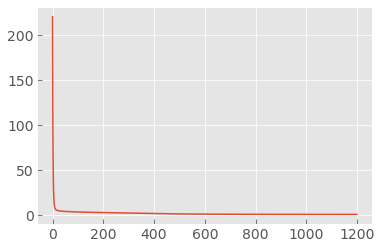

In [5]:
tf.random.set_seed(1)
np.random.seed(1)

m, q, _ = train_data[0].shape
p = 20

reg = 1
sm_factor = 10
smoothness = 1

sgpfa = SharedGpfa(m, q, p)
loss = sgpfa.fit(
    train_data=train_data,
    n_iters=1200,
    learning_rate=0.05,
    tensorboard=False,
    fa_init=False,
    reg=reg,
    sm_factor=sm_factor,
    smoothness=smoothness)

sgpfa.sort()
plt.plot(loss)

###  Similarity Between Subjects Topographies

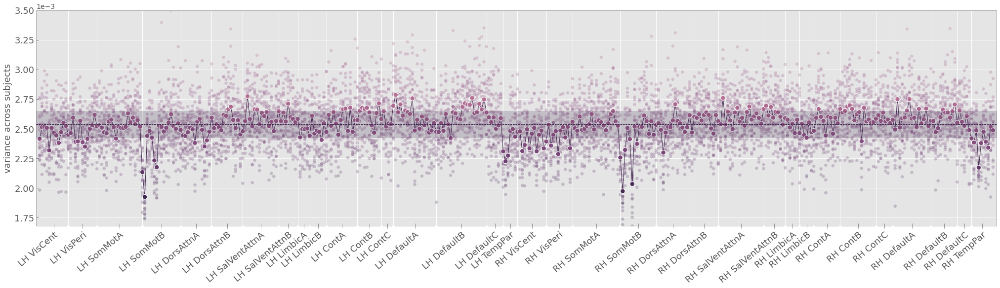

In [96]:
# We need to normalize topographies since each mode can have different strength.
# find the average norm of each brain map (across subjects)
# normalize each brain map

w = sgpfa.weights()
w = w / np.linalg.norm(w, axis=1).mean(0)
roi_vars = w.var(axis=0)
mean_roi_vars = roi_vars.mean(-1)


fig, ax = plt.subplots(figsize=(28, 8), constrained_layout=True)
cmap = sns.cubehelix_palette(dark=.2, light=.55, as_cmap=True).reversed()
c = 'k'
c = cmap(1)

norm = mpl.colors.Normalize(vmin=mean_roi_vars.min(), vmax=mean_roi_vars.max())
mrv = mean_roi_vars.copy()
color = cmap(norm(mrv))
ax.scatter(np.arange(q), mean_roi_vars, s=90, c=color, lw=1, ec='w', alpha=1, zorder=10)

norm = mpl.colors.Normalize(vmin=roi_vars.min(), vmax=roi_vars.max())
for v in roi_vars.T:
    color = cmap(norm(v))
    ax.scatter(np.arange(q), v, s=50, c=color, lw=1, ec='w', alpha=.25)
ax.plot(mean_roi_vars, color=c, marker='o', ms=7, mew=0.5, mec='w', lw=1)

ax.set_xlim(-1.5, q + 0.5)
ax.axhline(mean_roi_vars.mean(), c=c, ls='--', lw=1, zorder=1000)
ax.fill_between(ax.get_xlim(), mean_roi_vars.mean() + mean_roi_vars.std(), mean_roi_vars.mean() - mean_roi_vars.std(), color=c, alpha=.2, zorder=10000)


ax.set_ylabel('variance across subjects', fontsize=18)
ax.ticklabel_format(axis='y', style='sci', scilimits=(0, 0))
ax.autoscale(enable=True, axis='both', tight=True)
ptools.set_xlabels_atlas(ax, label_ticks, label_names, rotation=40)
for s in ax.spines.values():
    s.set_color('darkgray')
    s.set_lw(1)
ax.grid(lw=1, axis='x')

ax.set_ylim(ymax=3.5e-3)
ptools.font_size(fig, fs=18)

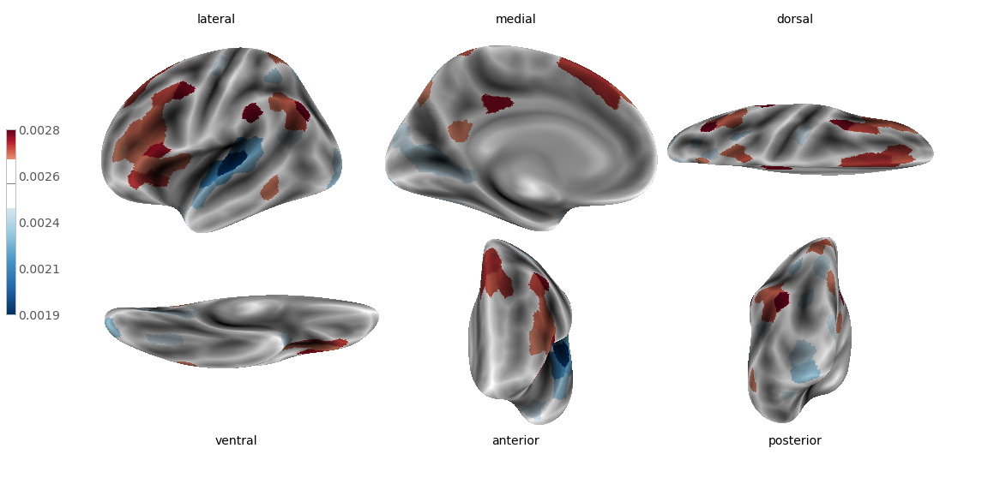

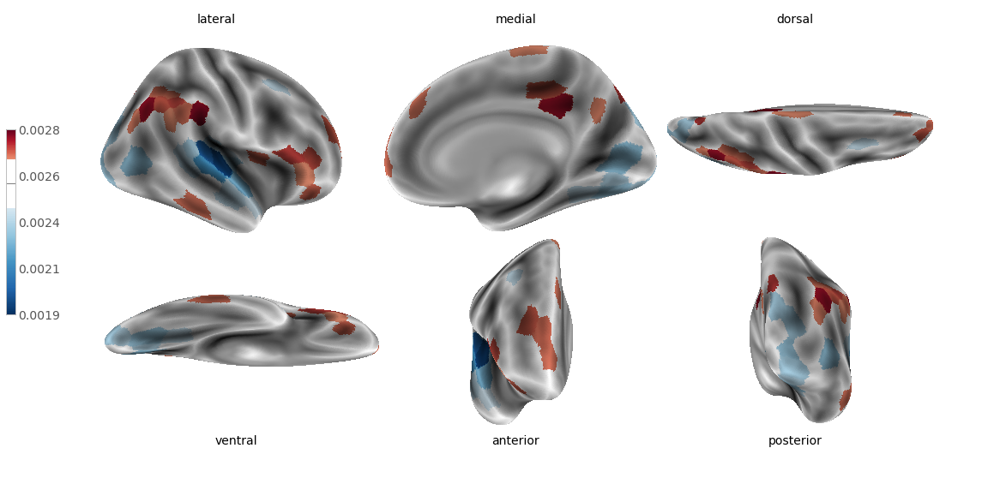

In [98]:
stat = mean_roi_vars.copy()

vmin, vmax = stat.min(), stat.max()
cmin = stat.mean() - stat.std()
cmax = stat.mean() + stat.std()

cmap_tool = (ptools.CmapTool('RdBu', vmin=vmin, vmax=vmax)
             .reverse()
             .change_center(stat.mean())
             .clip_inside(cmin, cmax)
             .set_nan(color='white', alpha=.9))
fig_brain = {}
for hemi in ('left', 'right'):
    fig_brain[hemi], ax = ptools.plot_all_brain_views(stat, hemi, cmap=cmap_tool.cmap, symmetric_cmap=False, vmin=vmin, vmax=vmax, fsaverage='fsaverage')
    fig_brain[hemi].findobj(plt.Axes)[-1].axhline(stat.mean(), color='k', lw=0.5)


In [8]:
yeo, label_ticks, label_names = get_atlas_ticks(platform)
spins, subdf, score = load_ea_data(vid=list(range(9)), filter_subs=True, platform=platform)

reg = 1
sm_factor = 10
smoothness = 1
p = 20
m, q, _ = spins[0].shape

weights = np.zeros((9, m, q, p))

for vid in tqdm(range(9)):

    tf.random.set_seed(1)
    np.random.seed(1)
    
    train_data = [spins[vid]]

    m, q, _ = train_data[0].shape
    sgpfa = SharedGpfa(m, q, p)
    loss = sgpfa.fit(
        train_data=train_data,
        n_iters=1200,
        learning_rate=0.05,
        tensorboard=False,
        fa_init=False,
        reg=reg,
        sm_factor=sm_factor,
        smoothness=smoothness)
    sgpfa.sort()
    
    weights[vid, ...] = sgpfa.weights()
    
np.save('weights', weights)

664.0



664.0



664.0



664.0



664.0



664.0



664.0



664.0



664.0


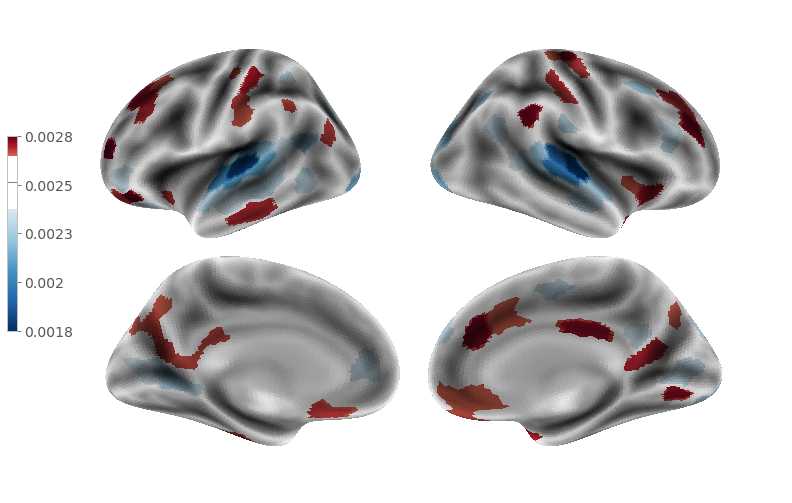

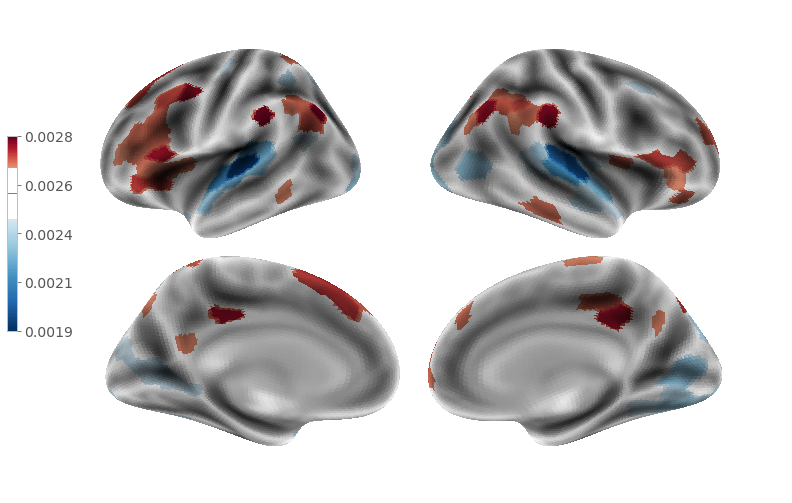

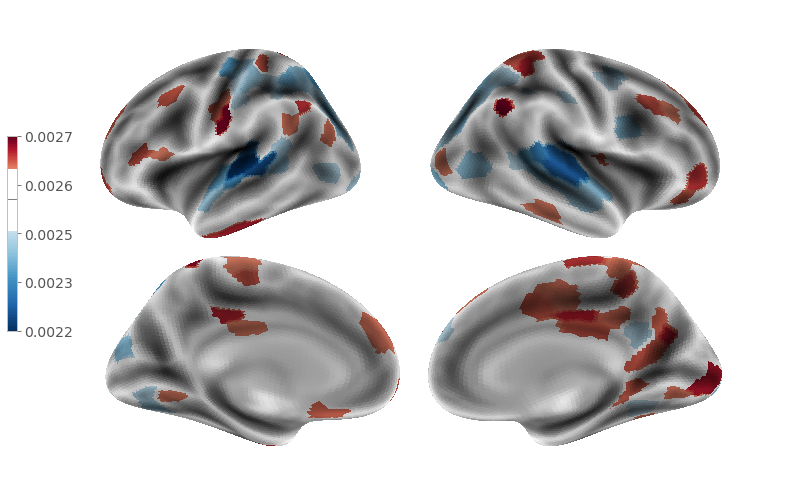

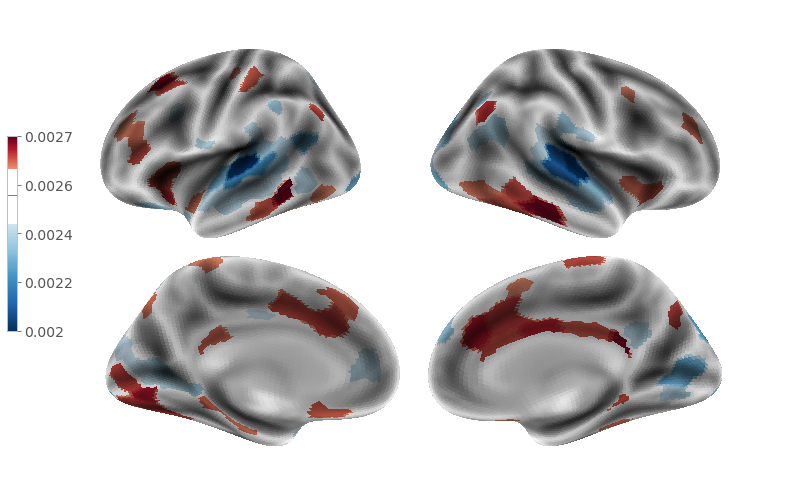

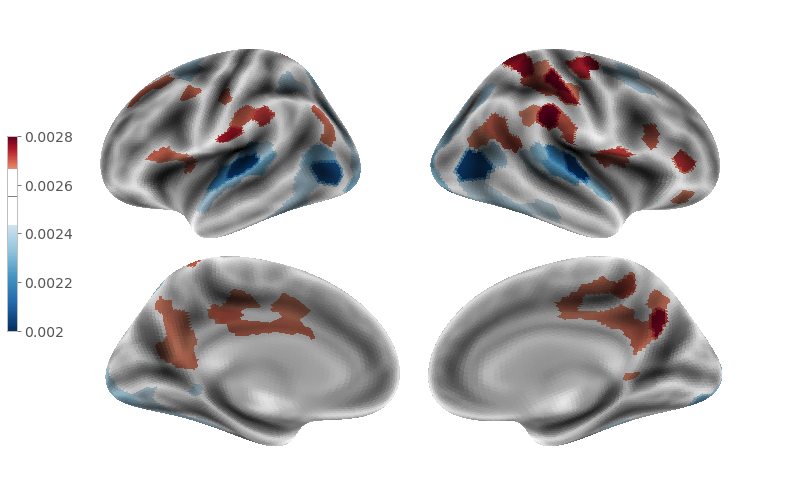

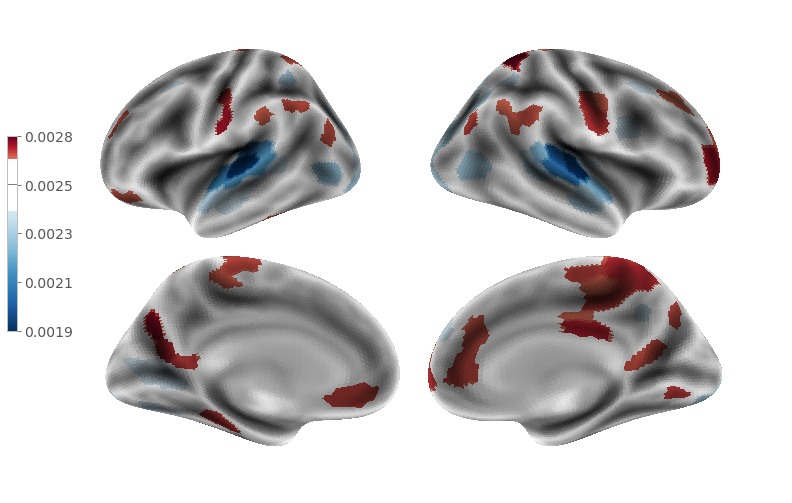

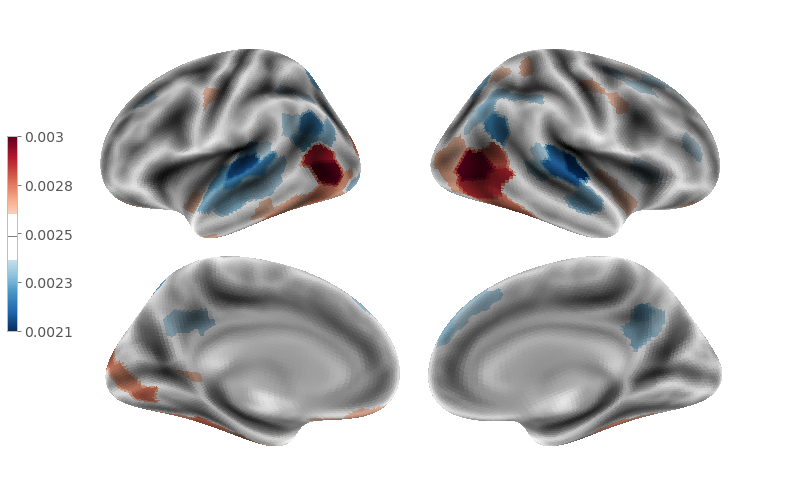

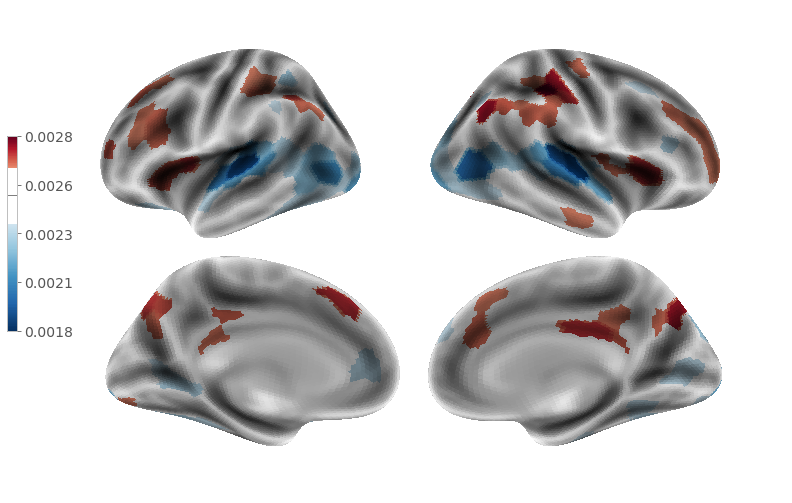

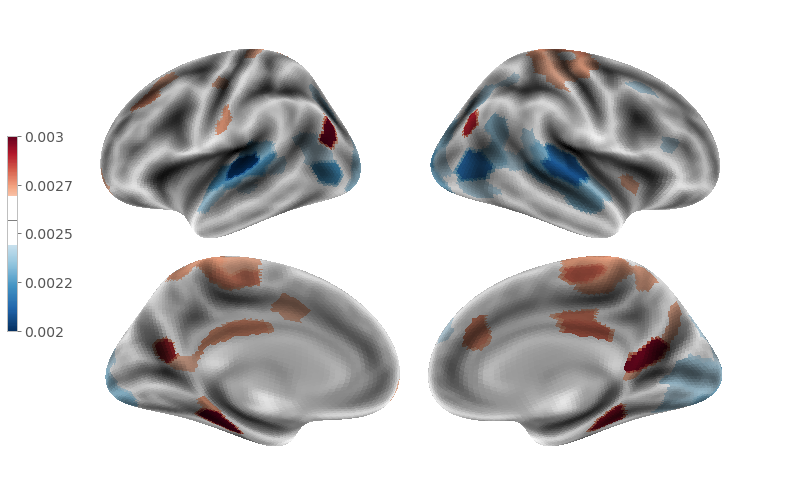

In [40]:
weights = np.load('weights.npy')

for vid in tqdm(range(9)):
    w = weights[vid, ...]
    w = w / np.linalg.norm(w, axis=1).mean(0)
    roi_vars = w.var(axis=0)
    mean_roi_vars = roi_vars.mean(-1)
    stat = mean_roi_vars.copy()

    vmin, vmax = stat.min(), stat.max()
    cmin = stat.mean() - stat.std()
    cmax = stat.mean() + stat.std()

    cmap_tool = (ptools.CmapTool('RdBu', vmin=vmin, vmax=vmax)
                 .reverse()
                 .change_center(stat.mean())
                 .clip_inside(cmin, cmax)
                 .set_nan(color='white', alpha=1))

    fig, axs = ptools.plot_brain_hemis(stat, cmap=cmap_tool.cmap, figsize=(15*0.9, 10*0.9), symmetric_cmap=False, vmin=vmin, vmax=vmax, fsaverage='fsaverage5')
    cax = fig.findobj(plt.Axes)[-1]
    cax.axhline(stat.mean(), color='k', lw=0.5)
    fig.savefig(f'Figures/topo_consistency_4/{vid}.png', transparent=True, dpi=250)


664.0



664.0



664.0



664.0



664.0



664.0



664.0


/mnt/tigrlab/projects/rebrahimi/shared-gpfa/plot_utils.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  subplot_kw={'projection': '3d', 'facecolor':(1,1,1,0)})


664.0


/home/rebrahimi/.conda/envs/sgpfa/lib/python3.6/site-packages/ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/mnt/tigrlab/projects/rebrahimi/shared-gpfa/plot_utils.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  subplot_kw={'projection': '3d', 'facecolor':(1,1,1,0)})
/mnt/tigrlab/projects/rebrahimi/shared-gpfa/plot_utils.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much m

664.0


/home/rebrahimi/.conda/envs/sgpfa/lib/python3.6/site-packages/ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/mnt/tigrlab/projects/rebrahimi/shared-gpfa/plot_utils.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  subplot_kw={'projection': '3d', 'facecolor':(1,1,1,0)})
/mnt/tigrlab/projects/rebrahimi/shared-gpfa/plot_utils.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much m

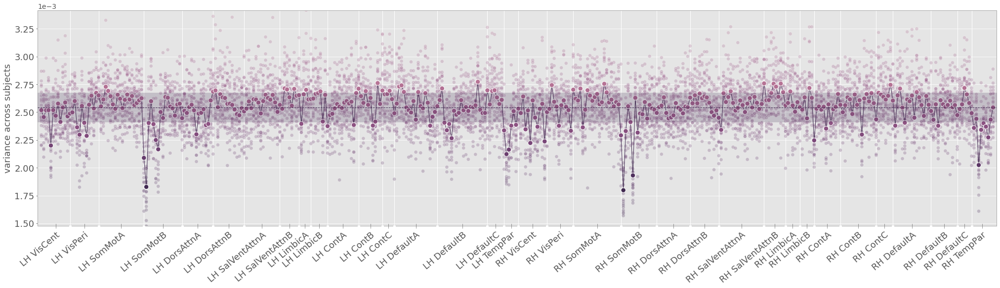

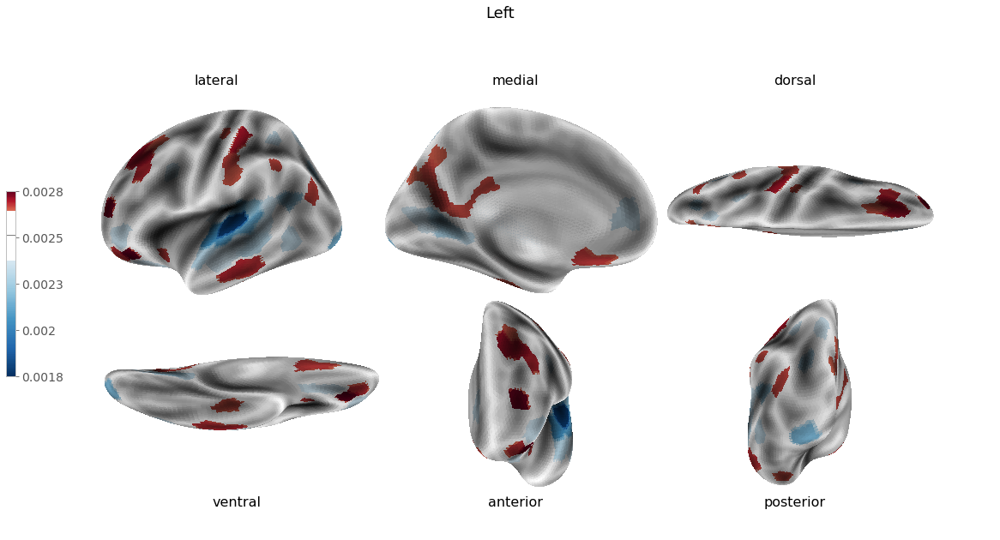

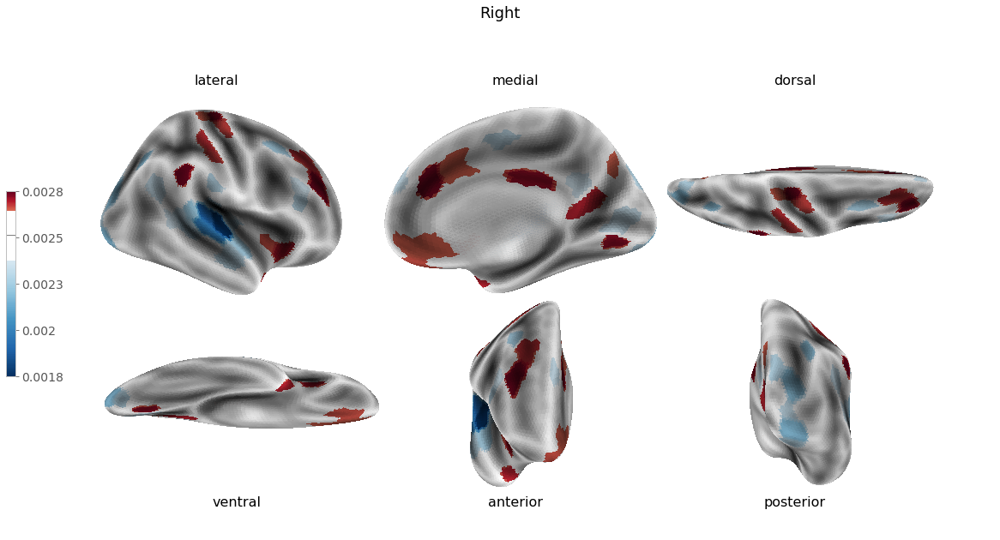

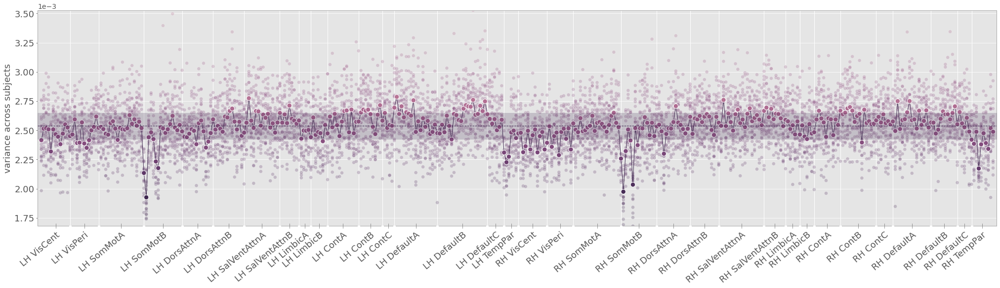

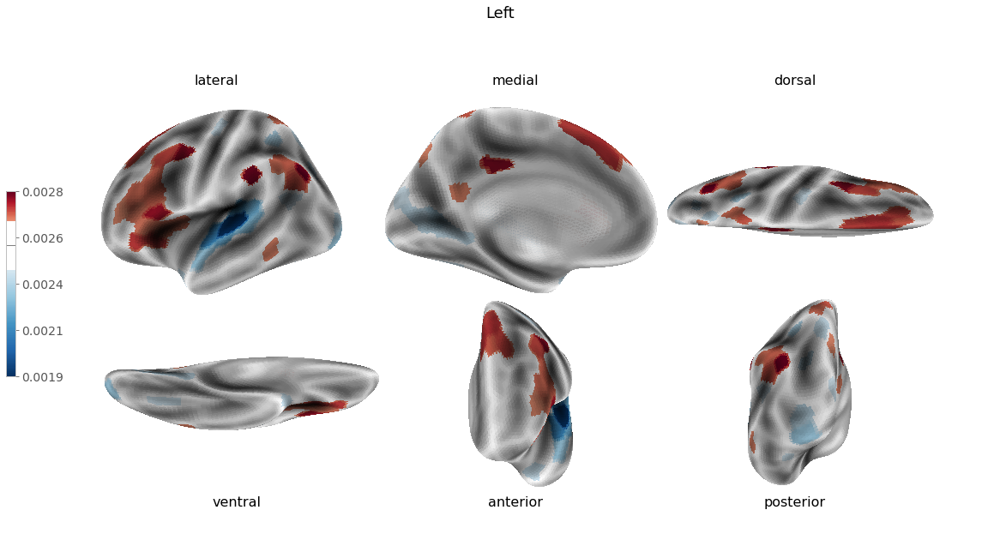

...

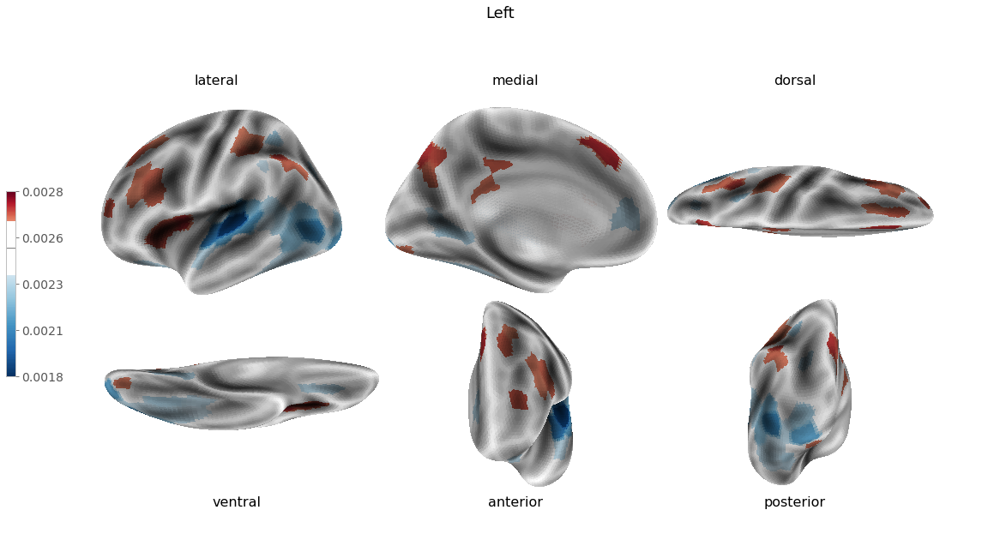

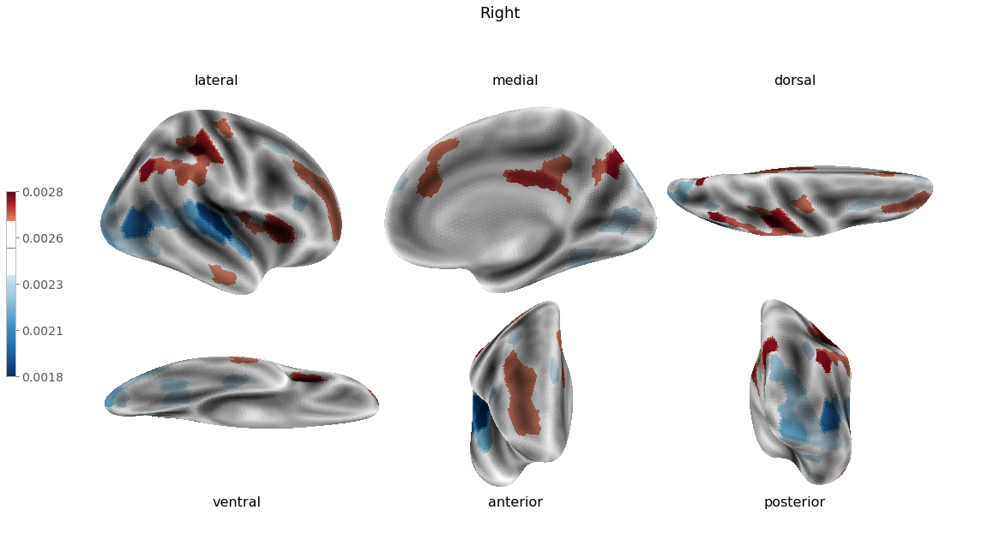

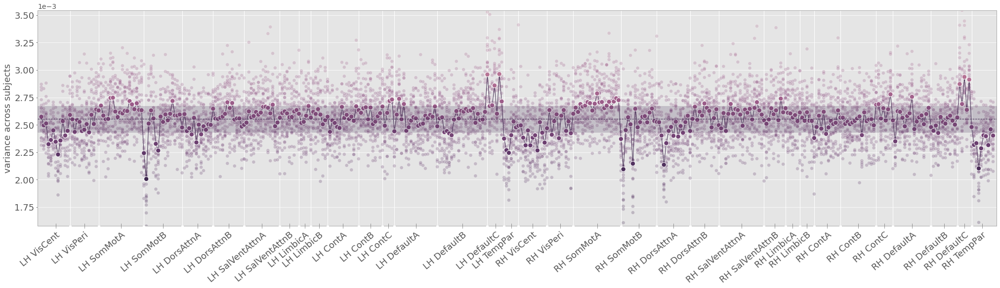

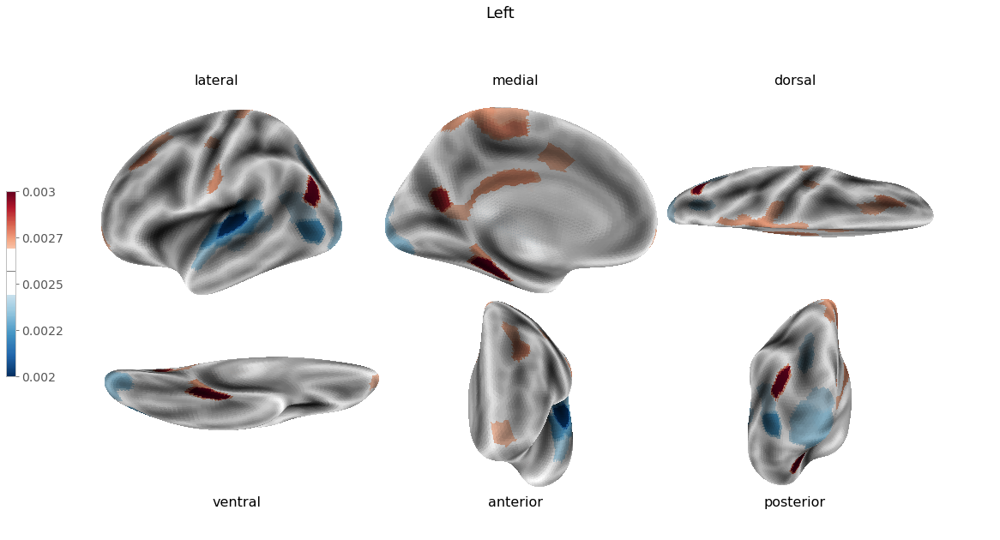

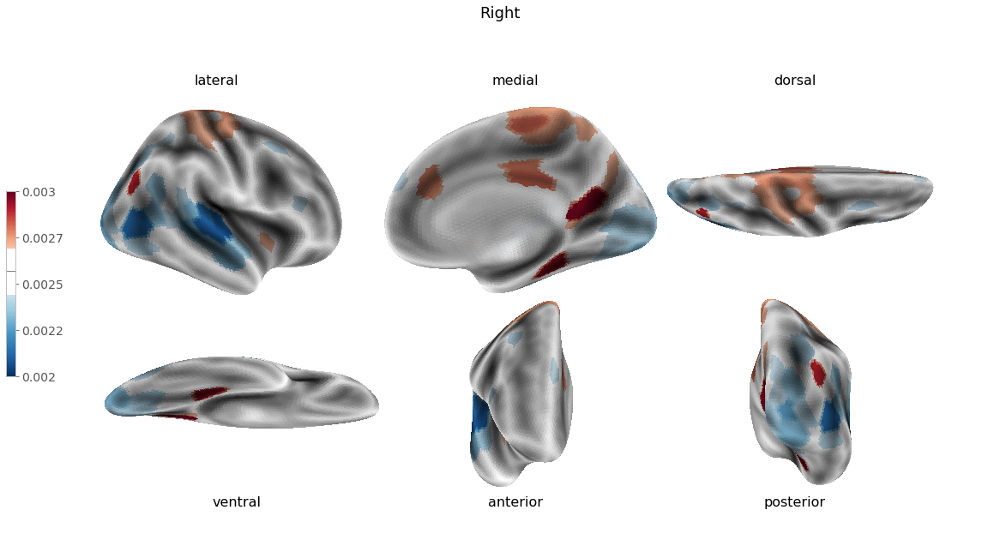

In [5]:
yeo, label_ticks, label_names = get_atlas_ticks(platform)
spins, subdf, score = load_ea_data(vid=list(range(9)), filter_subs=True, platform=platform)

reg = 1
sm_factor = 10
smoothness = 1
p = 20

for vid in tqdm(range(9)):

    tf.random.set_seed(1)
    np.random.seed(1)
    
    train_data = [spins[vid]]

    m, q, _ = train_data[0].shape
    sgpfa = SharedGpfa(m, q, p)
    loss = sgpfa.fit(
        train_data=train_data,
        n_iters=1200,
        learning_rate=0.05,
        tensorboard=False,
        fa_init=False,
        reg=reg,
        sm_factor=sm_factor,
        smoothness=smoothness)
    sgpfa.sort()

    # plot
    w = sgpfa.weights()
    w = w / np.linalg.norm(w, axis=1).mean(0)
    roi_vars = w.var(axis=0)
    mean_roi_vars = roi_vars.mean(-1)
    fig, ax = plt.subplots(figsize=(28, 8), constrained_layout=True)
    cmap = sns.cubehelix_palette(dark=.2, light=.55, as_cmap=True).reversed()
    c = 'k'
    c = cmap(1)
    norm = mpl.colors.Normalize(vmin=mean_roi_vars.min(), vmax=mean_roi_vars.max())
    mrv = mean_roi_vars.copy()
    color = cmap(norm(mrv))
    ax.scatter(np.arange(q), mean_roi_vars, s=90, c=color, lw=1, ec='w', alpha=1, zorder=10)
    norm = mpl.colors.Normalize(vmin=roi_vars.min(), vmax=roi_vars.max())
    for v in roi_vars.T:
        color = cmap(norm(v))
        ax.scatter(np.arange(q), v, s=50, c=color, lw=1, ec='w', alpha=.25)
    ax.plot(mean_roi_vars, color=c, marker='o', ms=7, mew=0.5, mec='w', lw=1)
    ax.set_xlim(-1.5, q + 0.5)
    ax.axhline(mean_roi_vars.mean(), c=c, ls='--', lw=1, zorder=1000)
    ax.fill_between(ax.get_xlim(), mean_roi_vars.mean() + mean_roi_vars.std(), mean_roi_vars.mean() - mean_roi_vars.std(), color=c, alpha=.2, zorder=10000)
    ax.set_ylabel('variance across subjects', fontsize=18)
    ax.ticklabel_format(axis='y', style='sci', scilimits=(0, 0))
    ax.autoscale(enable=True, axis='both', tight=True)
    ptools.set_xlabels_atlas(ax, label_ticks, label_names, rotation=40)
    for s in ax.spines.values():
        s.set_color('darkgray')
        s.set_lw(1)
    ax.grid(lw=1, axis='x')
#     ax.set_ylim(ymax=3.5e-3)
    ptools.font_size(fig, fs=18)    
    
    fig.savefig(f'Figures/topo_consistency_3/{vid}.png', dpi=300)
    fig.savefig(f'Figures/topo_consistency_3/{vid}.pdf')

    # Brain Plot
    stat = mean_roi_vars.copy()

    vmin, vmax = stat.min(), stat.max()
    cmin = stat.mean() - stat.std()
    cmax = stat.mean() + stat.std()

    cmap_tool = (ptools.CmapTool('RdBu', vmin=vmin, vmax=vmax)
                 .reverse()
                 .change_center(stat.mean())
                 .clip_inside(cmin, cmax)
                 .set_nan(color='white', alpha=.9))

    for hemi in ('left', 'right') :
        fig, ax = ptools.plot_all_brain_views(stat,
                                              hemi,
                                              cmap=cmap_tool.cmap,
                                              symmetric_cmap=False,
                                              vmin=vmin,
                                              vmax=vmax,
                                              fsaverage='fsaverage5',
                                              fontsize=16)
        fig.suptitle(hemi.capitalize(), fontsize=18)
        fig.findobj(plt.Axes)[-1].axhline(stat.mean(), color='k', lw=0.5)
        fig.savefig(f'Figures/topo_consistency_3/{vid}_{hemi}.png')
        fig.savefig(f'Figures/topo_consistency_3/{vid}_{hemi}.pdf')



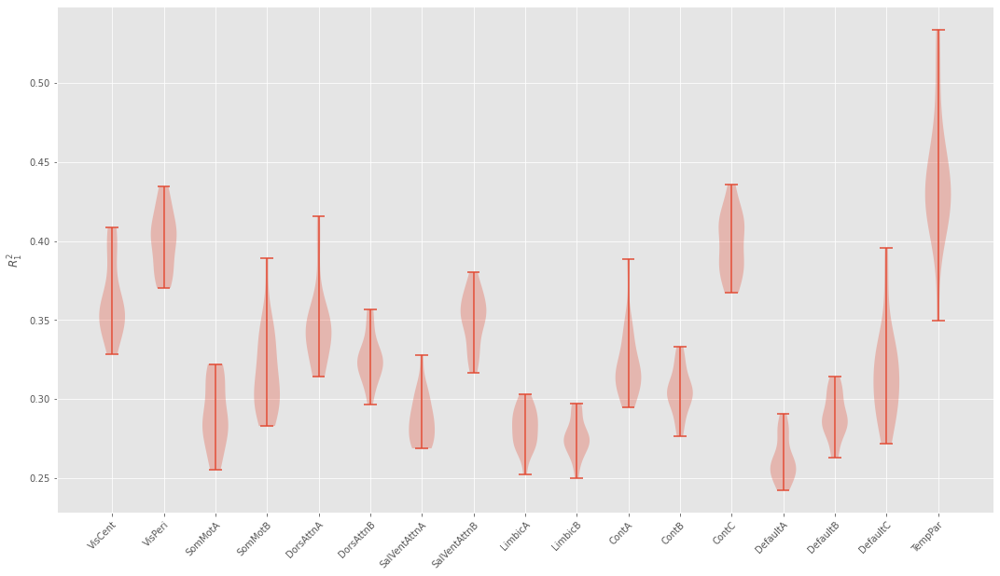

In [30]:
w = sgpfa.weights().transpose(-1, 0, 1)
m = sgpfa.m
regions = yeo.region.unique()
R2 = []

for r in regions:
    rid = yeo.region == r
    y = w[:, :, rid]
    y = y / np.linalg.norm(y, axis=-1, keepdims=True)
    _, s, _ = np.linalg.svd(y)
    R2.append(s[:, 0]**2 / m)
R2 = np.array(R2).T

fig, ax = plt.subplots(figsize=(18, 10))
ax.violinplot(R2)
ax.set_ylabel('$R_1^2$')
ax.set_xticks(np.arange(0, R2.shape[-1])+1)
ax.set_xticklabels(regions, rotation=45, ha='right', va='top', rotation_mode='anchor');

### Hierarchical Subject Clustering

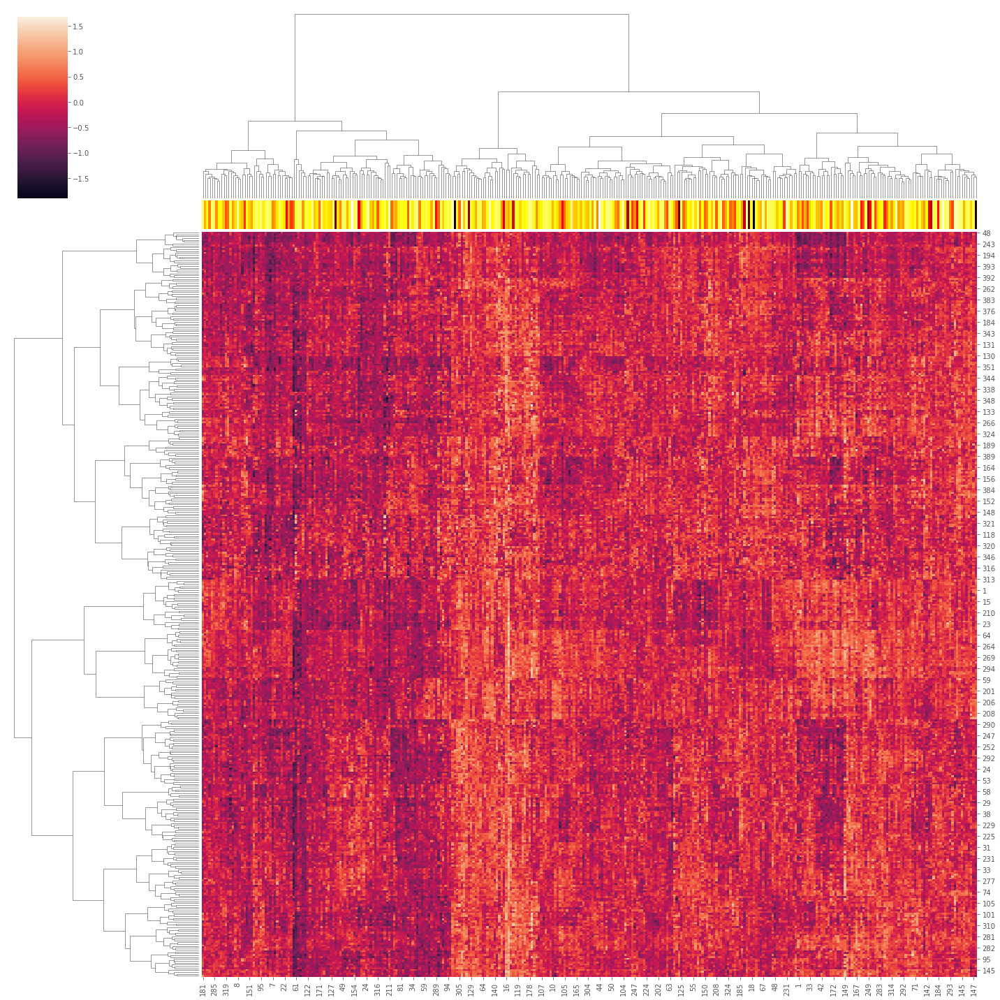

In [102]:
# Hierarchical Clustering
w = sgpfa.weights()[:, :, 10]
w = w.T

# col_colors = subdf.group.str.replace('case', 'r').str.replace('control', 'b').to_list()

ea_score = np.arctanh(subdf.filter(regex='score')).to_numpy()[:, :4].mean(1)
norm = mpl.colors.Normalize(vmin=ea_score.min(), vmax=ea_score.max())
cm = mpl.cm.get_cmap('hot')
col_colors = cm(norm(ea_score))

sns.clustermap(w, metric="euclidean", method="ward", standard_scale=None, figsize=(20, 20), col_colors=col_colors);

### Similar Time Points in Shared Trajectories

In [152]:
# Load SPINS data

train_data, _, _ = load_ea_data(vid=range(9), filter_subs=True, platform=platform)

# train_data = [d[subdf['is_prisma']] for d in train_data]

for vid, d in enumerate(train_data):
    print(f'video {vid}: ', d.shape)

video 0:  (332, 400, 85)
video 1:  (332, 400, 73)
video 2:  (332, 400, 55)
video 3:  (332, 400, 72)
video 4:  (332, 400, 69)
video 5:  (332, 400, 73)
video 6:  (332, 400, 59)
video 7:  (332, 400, 89)
video 8:  (332, 400, 64)


In [153]:
m, q, _ = train_data[0].shape
p = 20
sgpfa = SharedGpfa(m, q, p)

sm_factor = 10
sgpfa.fit(
    train_data=train_data,
    n_iters=1500,
    learning_rate=0.07,
    tensorboard=False,
    fa_init=False,
    reg=reg,
    sm_factor=sm_factor)
sgpfa.sort()

664.0


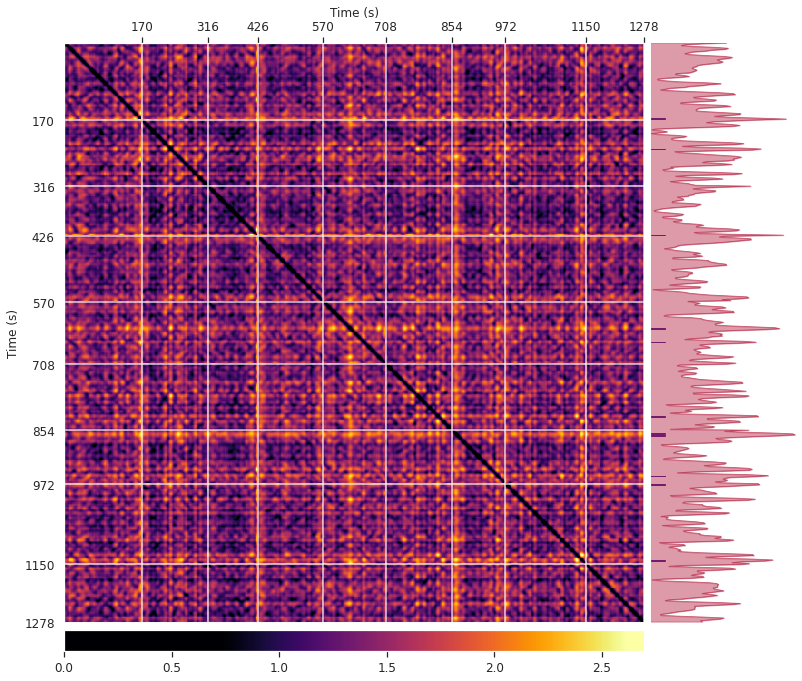

In [221]:
dist_mat = sp_distance.squareform(sp_distance.pdist(sgpfa.traj('all').T))

cm = mpl.cm.get_cmap('inferno', 256)
colors = cm(np.linspace(0, 1, 256))
black = np.repeat(colors[0].reshape(1, -1), 100, axis=0)
white = np.repeat(colors[-1].reshape(1, -1), 10, axis=0)
newcm = mpl.colors.ListedColormap(np.vstack((black, colors, white)))

fig, ax = plt.subplots(figsize=(11, 9), constrained_layout=True)

devider = make_axes_locatable(ax)
bax = devider.append_axes('right', size=2, pad=0.1)
cax = devider.append_axes('bottom', size=0.3, pad=0.1)

sim = dist_mat.mean(axis=1)
norm = mpl.colors.Normalize(vmin=sim.min(), vmax=sim.max())
# bax.barh(np.arange(len(sim)), sim, height=1, color=cm(norm(sim)))
c = cm(0.5)
bax.plot(sim, np.arange(dist_mat.shape[0]), color=c, lw=0.8, alpha=0.8)
bax.fill_betweenx(np.arange(len(sim)), [0], sim, color=c, alpha=0.5)
bax.set_xlim(sim.min(), sim.max())
bax.set_ylim(0, dist_mat.shape[0])

th = sim.mean() + 2 * sim.std()
# bax.axvline(th, ls=(0, (5, 10)), lw=1, color=newcm(.5))
for l in np.where(sim > th)[0]:
    bax.axhline(l, xmax=.1, color=newcm(.5), lw=1)
bax.invert_yaxis()
bax.set_axis_off()

im = ax.matshow(dist_mat, cmap=newcm)
fig.colorbar(im, cax=cax, orientation='horizontal')
ax.grid(lw=1.5, ls='-', alpha=0.8)
ax.set_xlabel('Time (s)')
ax.set_ylabel('Time (s)')
vid_onsets = np.cumsum(sgpfa.t)
ax.set_xticks(vid_onsets)
ax.set_xticklabels(vid_onsets * 2)
ax.set_yticks(vid_onsets)
ax.set_yticklabels(vid_onsets * 2)
ax.xaxis.tick_top()
ax.xaxis.set_label_position('top')

ptools.font_size(fig, 12)
# fig.suptitle('Distance between pairs of time points in shared space');

## Group Time Dynamics

In [ ]:
# p1 = 50
# p2 = 20
# sm_factor1 = 100
# sm_factor2 = 25
# reg = 1

In [20]:
# Load SPINS data


train_data, subdf, score = load_ea_data(vid=[0], filter_subs=True, platform=platform)
for d in train_data:
    print(d.shape)
    
yeo, label_ticks, label_names = get_atlas_ticks(platform)

(332, 400, 85)


In [25]:
# select subjects

train_data = [d[subdf['is_prisma'], :, :] for d in train_data]
score = score[subdf['is_prisma']]
subdf = subdf[subdf['is_prisma']]

In [27]:
# Group Labels

groups = subdf['group']

# groups = pd.qcut(score.mean(1), 3, labels=['Low', 'Medium', 'High'])

# groups = pd.qcut(score.mean(1), 4, labels=['Q1', 'Q2', 'Q3', 'Q4'])

# groups = pd.qcut(score.mean(1), [0, .2, .8, 1], labels=['Bottom 20%', 'Med', 'Top 20%'])
# train_data = [d[groups != 'Med'] for d in train_data]
# score = score[groups != 'Med']
# groups = groups[groups != 'Med']

In [28]:
# Make group sizes equal

group_idx = [np.where(groups == g)[0] for g in groups.unique()]
m = min([len(idx) for idx in group_idx])
group_idx = [idx[:m] for idx in group_idx]
sub_idx = np.concatenate(group_idx, 0)

train_data = [d[sub_idx] for d in train_data]
subdf, score = subdf.iloc[sub_idx, :], score.iloc[sub_idx, :]
groups = groups.iloc[sub_idx]

for d in train_data:
    print(d.shape)

(126, 400, 85)


1- Fit a model on both groups, find the rediduals: This has the part shared among both groups removed.  
2- Fit a model for each group separatly, map the shared latent trajectory to the observaition space.
Any differences in tyme dynamics?

10.08



63
25.2



63
25.2


[-10.0, 100.0, -10.0, 100.0, -10.0, 100.0]

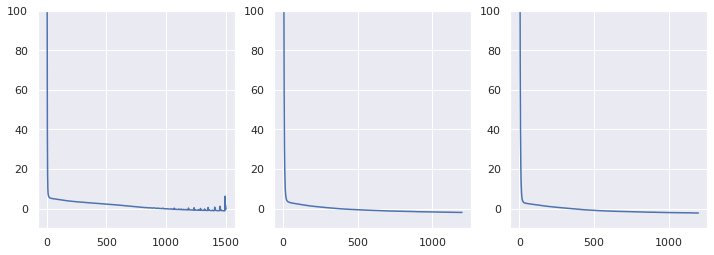

In [29]:
# fit a model on all groups

fig, axs = plt.subplots(1, 3, figsize=(12, 4))

tf.random.set_seed(1)
np.random.seed(1)

p1 = 50
p2 = 20
sm_factor1 = 100
sm_factor2 = 50
reg = 1

m1, q, _ = train_data[0].shape
sgpfa1 = SharedGpfa(m1, q, p1)
loss = sgpfa1.fit(
    train_data=train_data,
    n_iters=1500,
    learning_rate=0.05,
    tensorboard=False,
    fa_init=False,
    reg=reg,
    sm_factor=sm_factor1,
    smoothness=1,
    desc='Fitting SGPFA for all groups')
# sgpfa1.sort()
axs[0].plot(loss)

# find the residuals
residual = []
for i, y in enumerate(train_data):
    _residual = y - sgpfa1.weights() @ sgpfa1.traj(exp=i)
    residual.append(_residual)

i = 0

sgpfa2 = {}
for g in groups.unique():
    residual_group = [res[groups == g] for res in residual]
    m2, q, _ = residual_group[0].shape
    print(m2)
    sgpfa2[g] = SharedGpfa(m2, q, p2)
    loss = sgpfa2[g].fit(
        train_data=residual_group,
        n_iters=1200,
        learning_rate=0.03,
        tensorboard=False,
        fa_init=False,
        reg=reg,
        sm_factor=sm_factor2,
        desc=f'Fitting SGPFA for {g}')
    sgpfa2[g].sort()
    
    i += 1
    axs[i].plot(loss)
    
plt.setp(axs, ylim=(-10, 100))

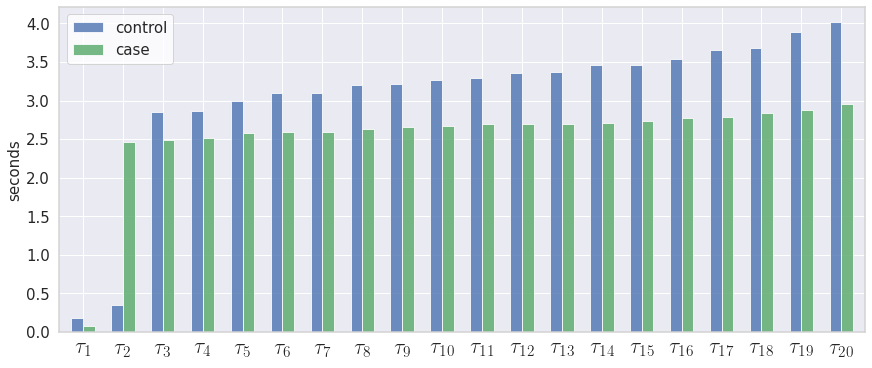

In [30]:
fig, ax = plt.subplots(figsize=(12, 5), constrained_layout=True)
ptools.spine(fig)
ptools.font_size(fig, 15)

M = len(groups.unique())
pos = np.arange(M) - (M - 1) / 2
width = 1 / (M + 1.4)

unit = 's'
for g, _pos, c in zip(groups.unique()[::-1], pos, ('b', 'g', 'y', 'r')):
    ax.bar(np.arange(p2) + _pos * width, sgpfa2[g].len_scale(unit=unit), label=g, width=width, color=c, alpha=0.8)
# ax.set_xlabel('Latent Dimension')
ax.set_ylabel('seconds' if unit == 's' else '')
ax.legend(loc=2, fontsize=15)
ax.set_xticks(np.arange(p2))

ax.set_xticklabels([fr'$\tau_{{{i}}}$' for i in np.arange(p2)+1], usetex=True, fontsize=22)

# ax.set_title('Timescale')
ax.set_xlim(-2 * width, p2-.4);
# ax.set_ylim(0, 100)

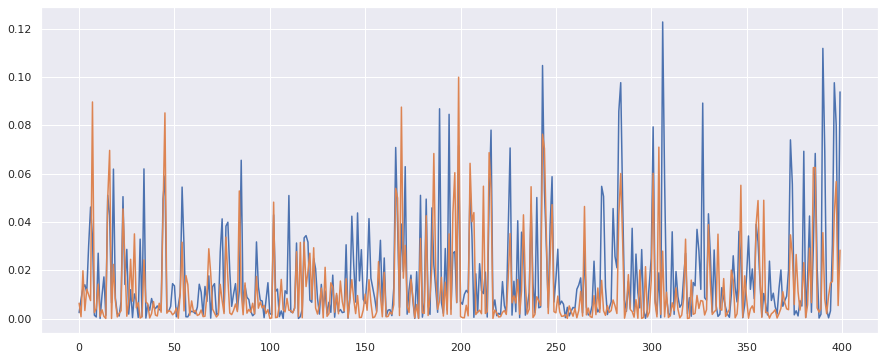

In [392]:
fig, ax = plt.subplots(figsize=(15, 6))
w1 = sgpfa2['Top 20%'].weights().mean(0)
w2 = sgpfa2['Bottom 20%'].weights().mean(0)
pp = 4
dist = np.linalg.norm(np.abs(w1[:, pp].reshape(-1, 1)) - np.abs(w2), axis=0)

ax.plot(np.abs(w1[:, pp]))
ax.plot(np.abs(w2[:, dist.argmin()]))

In [ ]:
regions = yeo.region.unique()

for r in regions:
    rid = yeo.region == r
    y = w[:, :, rid]


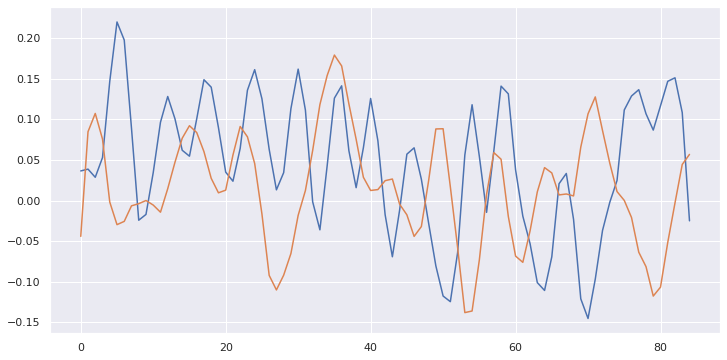

In [354]:
x = sgpfa2['Bottom 20%'].traj()
y = sgpfa2['Top 20%'].traj()
plt.figure(figsize=(12,6))
plt.plot(x[0])
plt.plot(x[-1])

Text(0.5, 1.0, 'Length Scale')

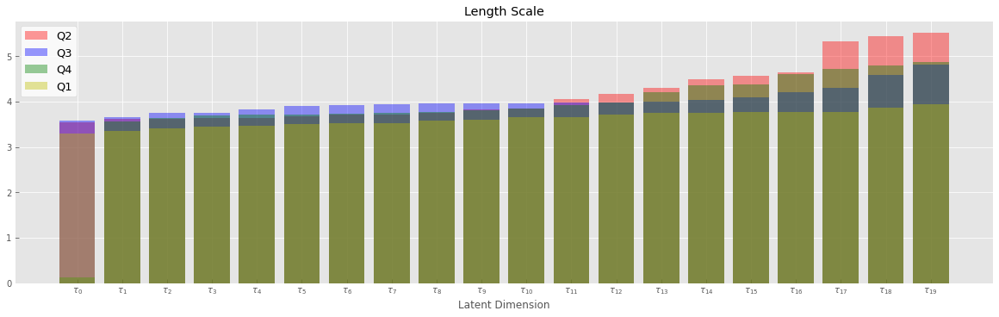

In [86]:
fig, ax = plt.subplots(figsize=(16, 5), constrained_layout=True)
for g, c in zip(groups.unique(), ('r', 'b', 'g', 'y')):
    ax.bar(np.arange(p2), sgpfa2[g].len_scale(), alpha=0.4, label=g, color=c)
ax.set_xlabel('Latent Dimension')
ax.legend(loc=2)
ax.set_xticks(np.arange(p2))
ax.set_xticklabels([fr'$\tau_{{{i}}}$' for i in range(p2)])
ax.set_title('Length Scale')

In [8]:
for model in [sgpfa1]:
    print(model.m, model.q, model.p, model.t)
for model in sgpfa2.values():
    print(model.m, model.q, model.p, model.t)

68 400 40 [85, 73, 55]
34 400 20 [85, 73, 55]
34 400 20 [85, 73, 55]


0.11794923

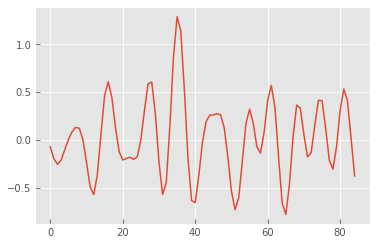

In [114]:
n = 0
plt.plot(sgpfa2['Q4'].traj()[n])
sgpfa2['Q4'].len_scale()[n]
# plt.plot(train_data[1][100,99,:])

# Model Selection: Laplace Approximation

In [2]:
tf.random.set_seed(10)
np.random.seed(10)

# Simulate data:
p = 5
q = 30
m = 4
t = 80

length_scale = np.arange(1, p + 1)
# length_scale = np.array([1, 5])
# length_scale = np.array([5, 1])
subject_noise_scale = np.linspace(.1, .5, m)
roi_noise_scale = np.linspace(.1, .5, q)

# length_scale = np.array([1, 4])
# subject_noise_scale = np.array([0.1]*m)
# roi_noise_scale = np.array([0.1]*q)

generator = SharedGpfa(m, q, p, name='True')
generator.t = [t]
generator.init_vars()
generator.init_joint()
generator.vars['length_scale'].assign(length_scale)
generator.vars['subject_noise_scale'].assign(subject_noise_scale)
generator.vars['roi_noise_scale'].assign(roi_noise_scale)

s = generator.joint[0].sample()
generator.vars['x'][0].assign(s['x'])
generator.vars['w'].assign(s['w'])
train_data = s['obs'].numpy()
generator.sort()

Text(0, 0.5, 'Evidence')

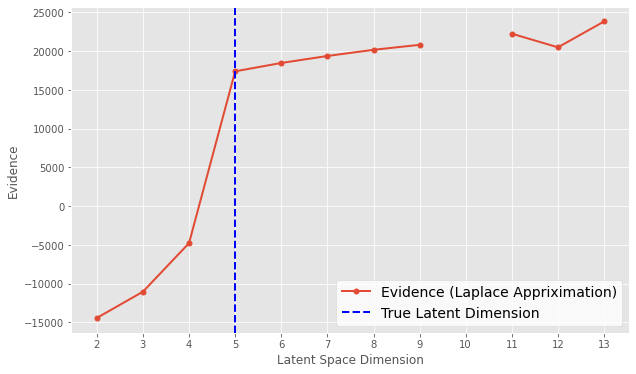

In [6]:
# fit SGPFA
sm_factor = 20
smoothness = 1
reg = 1

p_range = np.arange(2, 14)
evidence = []
pbar = tqdm(p_range)
for p in pbar:
    sgpfa = SharedGpfa(m, q, p)
    pbar.set_description(f'Fiiting SGPFA: p = {p}')
    loss = sgpfa.fit(
        train_data=[train_data],
        n_iters=2000,
        learning_rate=0.03,
        tensorboard=False,
        fa_init=False,
        reg=reg,
        sm_factor=sm_factor,
        smoothness=smoothness,
        disable=True)
    pbar.set_description(f'Calculating Evidence: p = {p}')
    _evidence = sgpfa.evidence_laplace(train_data)
#     _evidence = sgpfa.modified_bic(train_data)
#     _evidence = sgpfa.aic(train_data)

    evidence.append(_evidence)
    
plt.figure(figsize=(10,6))
plt.plot(p_range[:len(evidence)], evidence, marker='.', ms=10, lw=2, label='Evidence (Laplace Appriximation)')
plt.axvline(5, ls='--', lw=2, color='b', label='True Latent Dimension')
plt.legend()
plt.xticks(p_range[:len(evidence)])
plt.xlabel('Latent Space Dimension')
plt.ylabel('Evidence')

In [23]:
# Load SPINS data

train_data, subdf, score = load_ea_data(vid=[0], filter_subs=True, platform=platform)

train_data[0] = train_data[0][(subdf['subject_id'].str[:3] == 'CMH')]

for d in train_data:
    print(d.shape)

yeo, label_ticks, label_names = get_atlas_ticks(platform)

(332, 400, 85)


In [24]:
m, q, _ = train_data[0].shape
p = 20

reg = 1
sm_factor = 10

p_range = np.arange(1, 21)
evidence = []
for p in p_range:
    sgpfa = SharedGpfa(m, q, p)
    sgpfa.fit(
        train_data=train_data,
        n_iters=1000,
        learning_rate=0.08,
        tensorboard=False,
        fa_init=False,
        reg=reg,
        sm_factor=sm_factor)
    _evidence = sgpfa.evidence_laplace(train_data)
    evidence.append(_evidence)
    print(f'{p}: {_evidence: .4f}')


ResourceExhaustedError:  OOM when allocating tensor of shape [49007,121,400,1] and type float
	 [[{{node loop_body/AddN_6/pfor/AddN/tmp_var_zeros}}]] [Op:__inference_f_14719]

Function call stack:
f


In [20]:
import srm